In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import h5py # >7.3的高版本mat文件
import torch
from torchvision import transforms
from torchvision import datasets
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim
from Net import *
import cv2
# import rawpy

In [ ]:
# train_pathes=[f'./dataset/training/{i+1}.mat' for i in range(2757)]
test_pathes=[f'./dataset/testing/{i+1}.mat' for i in range(2757, 3064)]
pathes=test_pathes

In [ ]:
# label: 1 for meningioma, 2 for glioma, 3 for pituitary tumor
# PID: patient ID
# image: image data
# tumorBorder: a vector storing the coordinates of discrete points on tumor border.
#     For example, [x1, y1, x2, y2,...] in which x1, y1 are planar coordinates on tumor border.
#     It was generated by manually delineating the tumor border. So we can use it to generate
#     binary image of tumor mask.
# tumorMask: a binary image with 1s indicating tumor region

In [ ]:
# 类定义，方便之后操作数据
class SampleImage:
    def __init__(self, path):
        with h5py.File(path, 'r') as f:
            self.PID=np.array(f['cjdata']['PID'])
            self.image=np.array(f['cjdata']['image'])
            self.label=np.array(f['cjdata']['label'][0][0])
            self.tumorBorder=np.array(f['cjdata']['tumorBorder'][0])
            self.tumorMask=np.array(f['cjdata']['tumorMask'])

In [ ]:
import os
import numpy as np
def checkout(dir_path):
    for i in os.walk(dir_path):
        name_list=i[2]
        try:
            name_list.remove('.DS_Store')
        except:
            pass
    for name in name_list:
        data_path=dir_path+name
        img=SampleImage(data_path).image
        img=(img-np.min(img))/(np.max(img)-np.min(img))
        yield img, np.max(img)

In [ ]:
import os
import numpy as np
def get_path(dir_path):
    for i in os.walk(dir_path):
        name_list=i[2]
        try:
            name_list.remove('.DS_Store')
        except:
            pass
    for name in name_list:
        data_path=dir_path+name
        img=SampleImage(data_path).image
        img256=cv2.resize(img, (256, 256), interpolation=cv2.INTER_CUBIC)
        img512=cv2.resize(img256, (512, 512), interpolation=cv2.INTER_CUBIC)
        yield img, img256, img512

In [ ]:
generator=get_path('./dataset/training/')

In [ ]:
(img, img256, img512)=next(generator)
plt.figure(figsize=(20, 30))
plt.subplot(131)
plt.imshow(img, 'gray')
plt.title('original')
plt.subplot(132)
plt.imshow(img256, 'gray')
plt.title('dowmsampled')
plt.subplot(133)
plt.imshow(img512, 'gray')
plt.title('re-upsampled')
plt.show()

In [ ]:
shapes=[]
count=0
for path in pathes:
    sampleimage=SampleImage(path)
    if sampleimage.image.shape == (256, 256):
        count+=1
        print(path)
print(count)
[955, 956, 957, 1070, 1071, 1072, 1073, 1074, 1075, 1076, 1203, 1204, 1205, 1206, 1207]

In [ ]:
plt.imshow(sampleimage.image/256, 'gray')

In [ ]:
print(np.max(sampleimage.image))
pil_img=Image.fromarray(sampleimage.image)
img_array=np.array(pil_img).astype('uint8')
print(np.max(img_array))

In [ ]:
plt.imshow(sampleimage.tumorMask, 'gray')

In [ ]:
type(sampleimage.tumorMask[0][0])

In [ ]:
print(sampleimage.label)

In [ ]:
%matplotlib inline
images=[]
for path in pathes:
    f=h5py.File(path, 'r')
    data=f['cjdata']# 读取mat文件到data中
    fields=list(data.keys()) # 可以获取到字典的key
    images.append(np.array(data['image']))
for i in range(len(images)):
    plt.subplot(3, 4, i+1)
    plt.imshow(images[i], 'gray')
    plt.axis('off')
plt.show()

In [ ]:
mask=np.array(data['tumorMask'])

In [ ]:
plt.imshow(mask, 'gray')
plt.axis('off')
plt.show()

In [ ]:
f=h5py.File('./dataset/1.mat', 'r')
data=f['cjdata']# 读取mat文件到data中
image1=np.array(data['image'])
mask=np.array(data['tumorMask'])

In [ ]:
%matplotlib inline
plt.subplot(121)
plt.imshow(image1, 'gray')
plt.axis('off')
plt.subplot(122)
plt.imshow(mask, 'gray')
plt.axis('off')
plt.show()

In [ ]:
import numpy as np
arr=np.array([[1, 2], [3, 4]])
print(arr)
print(np.flip(arr, -2))

True
第1轮次已训练300批样本, 本批次平均loss值: 0.5786426300803821
第1轮次已训练600批样本, 本批次平均loss值: 0.5007490304112434
第1轮次已训练900批样本, 本批次平均loss值: 0.4486641694108645
第1轮次已训练1200批样本, 本批次平均loss值: 0.4290171429514885
第1轮次已训练1500批样本, 本批次平均loss值: 0.40659005790948866
第1轮次已训练1800批样本, 本批次平均loss值: 0.3954077450434367
第1轮次已训练2100批样本, 本批次平均loss值: 0.3818525515993436
第1轮次已训练2400批样本, 本批次平均loss值: 0.38425618211428325
第1轮次已训练2700批样本, 本批次平均loss值: 0.3738180747628212
current epoch average cross entropy loss: 0.4191332161426544
Dice score 0.4558910597986974


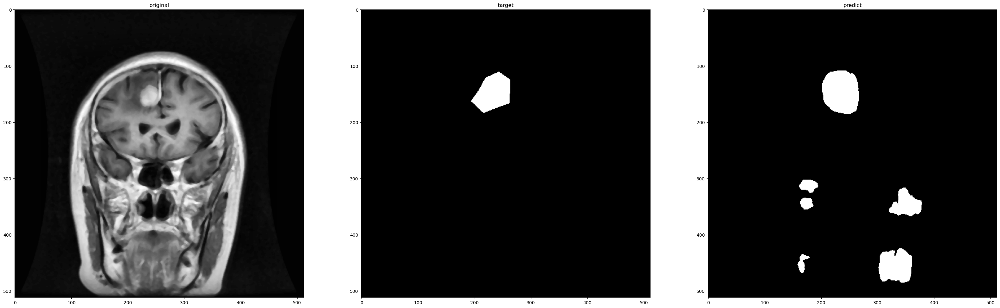

第2轮次已训练300批样本, 本批次平均loss值: 0.37695365369319916
第2轮次已训练600批样本, 本批次平均loss值: 0.36425964325666427
第2轮次已训练900批样本, 本批次平均loss值: 0.3740559049447377
第2轮次已训练1200批样本, 本批次平均loss值: 0.36094712406396867
第2轮次已训练1500批样本, 本批次平均loss值: 0.3652290579676628
第2轮次已训练1800批样本, 本批次平均loss值: 0.36727965652942657
第2轮次已训练2100批样本, 本批次平均loss值: 0.3671013299624125
第2轮次已训练2400批样本, 本批次平均loss值: 0.36177795271078744
第2轮次已训练2700批样本, 本批次平均loss值: 0.36743748644987745
current epoch average cross entropy loss: 0.3960277736186981
Dice score 0.6364342590794327


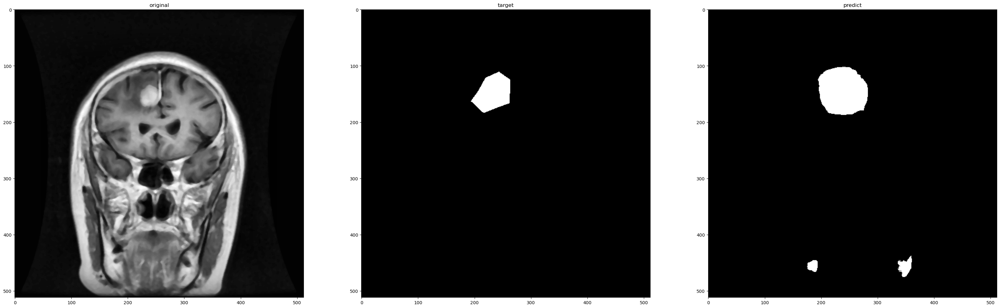

第3轮次已训练300批样本, 本批次平均loss值: 0.3547693607211113
第3轮次已训练600批样本, 本批次平均loss值: 0.36529548664887745
第3轮次已训练900批样本, 本批次平均loss值: 0.3626403052608172
第3轮次已训练1200批样本, 本批次平均loss值: 0.354327461818854
第3轮次已训练1500批样本, 本批次平均loss值: 0.35181369026501974
第3轮次已训练1800批样本, 本批次平均loss值: 0.356022758881251
第3轮次已训练2100批样本, 本批次平均loss值: 0.35815096805493035
第3轮次已训练2400批样本, 本批次平均loss值: 0.36071916749080024
第3轮次已训练2700批样本, 本批次平均loss值: 0.36165566354990003
current epoch average cross entropy loss: 0.39963197708129883
Dice score 0.480691056910569


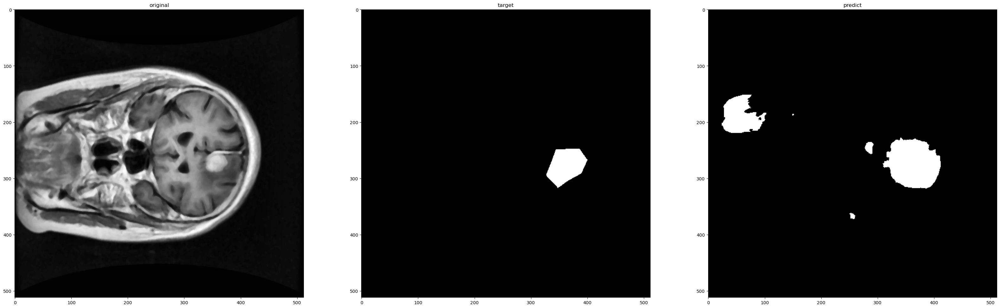

第4轮次已训练300批样本, 本批次平均loss值: 0.3539325749874115
第4轮次已训练600批样本, 本批次平均loss值: 0.3576778444647789
第4轮次已训练900批样本, 本批次平均loss值: 0.3530607763926188
第4轮次已训练1200批样本, 本批次平均loss值: 0.3517589643597603
第4轮次已训练1500批样本, 本批次平均loss值: 0.355574076573054
第4轮次已训练1800批样本, 本批次平均loss值: 0.3472991552948952
第4轮次已训练2100批样本, 本批次平均loss值: 0.3505174174904823
第4轮次已训练2400批样本, 本批次平均loss值: 0.35316723157962165
第4轮次已训练2700批样本, 本批次平均loss值: 0.35408963332573573
current epoch average cross entropy loss: 0.39374738931655884
Dice score 0.5708109977520317


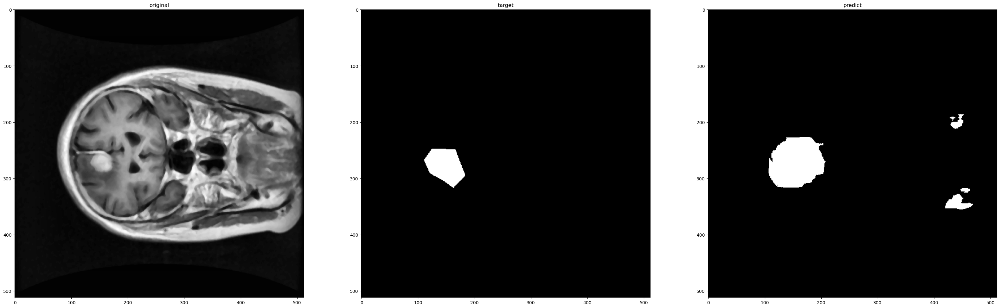

第5轮次已训练300批样本, 本批次平均loss值: 0.3507535003622373
第5轮次已训练600批样本, 本批次平均loss值: 0.34840412815411886
第5轮次已训练900批样本, 本批次平均loss值: 0.3529425926009814
第5轮次已训练1200批样本, 本批次平均loss值: 0.3490169276793798
第5轮次已训练1500批样本, 本批次平均loss值: 0.3507789499560992
第5轮次已训练1800批样本, 本批次平均loss值: 0.3520975429813067
第5轮次已训练2100批样本, 本批次平均loss值: 0.3477047216892242
第5轮次已训练2400批样本, 本批次平均loss值: 0.35292436271905897
第5轮次已训练2700批样本, 本批次平均loss值: 0.350929823021094
current epoch average cross entropy loss: 0.3826829195022583
Dice score 0.6745983323164529


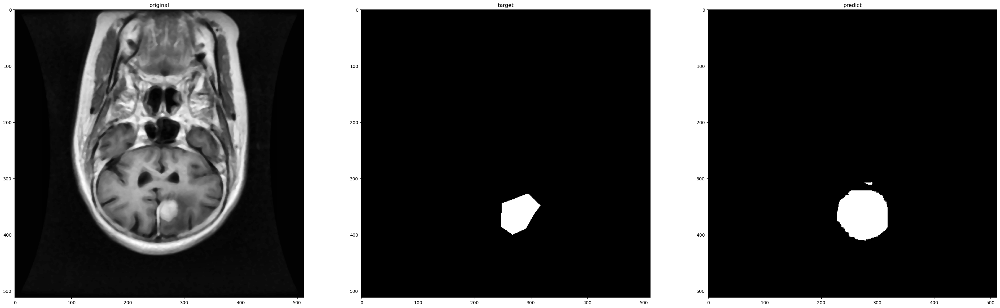

第6轮次已训练300批样本, 本批次平均loss值: 0.3489262703061104
第6轮次已训练600批样本, 本批次平均loss值: 0.3507454680403074
第6轮次已训练900批样本, 本批次平均loss值: 0.34588154693444567
第6轮次已训练1200批样本, 本批次平均loss值: 0.349078973531723
第6轮次已训练1500批样本, 本批次平均loss值: 0.34737495323022205
第6轮次已训练1800批样本, 本批次平均loss值: 0.3449689029653867
第6轮次已训练2100批样本, 本批次平均loss值: 0.34793378591537477
第6轮次已训练2400批样本, 本批次平均loss值: 0.35063331107298534
第6轮次已训练2700批样本, 本批次平均loss值: 0.34668342471122743
current epoch average cross entropy loss: 0.38668718934059143
Dice score 0.7036604774535807


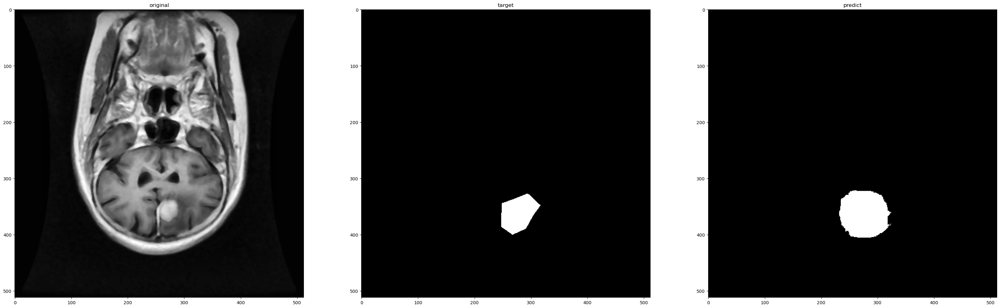

第7轮次已训练300批样本, 本批次平均loss值: 0.34656529118617374
第7轮次已训练600批样本, 本批次平均loss值: 0.3487319108843803
第7轮次已训练900批样本, 本批次平均loss值: 0.34754016558329265
第7轮次已训练1200批样本, 本批次平均loss值: 0.3431020388007164
第7轮次已训练1500批样本, 本批次平均loss值: 0.3467579820752144
第7轮次已训练1800批样本, 本批次平均loss值: 0.34487482835849126
第7轮次已训练2100批样本, 本批次平均loss值: 0.3497471625606219
第7轮次已训练2400批样本, 本批次平均loss值: 0.34591276963551837
第7轮次已训练2700批样本, 本批次平均loss值: 0.3479152956604958
current epoch average cross entropy loss: 0.4016159176826477
Dice score 0.718171160609613


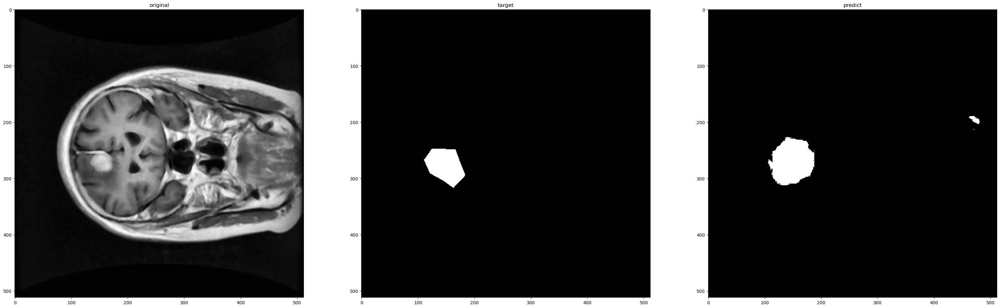

第8轮次已训练300批样本, 本批次平均loss值: 0.3403901504476865
第8轮次已训练600批样本, 本批次平均loss值: 0.3439728174606959
第8轮次已训练900批样本, 本批次平均loss值: 0.34892868985732395
第8轮次已训练1200批样本, 本批次平均loss值: 0.34447954575220746
第8轮次已训练1500批样本, 本批次平均loss值: 0.34428486178318657
第8轮次已训练1800批样本, 本批次平均loss值: 0.3450553302963575
第8轮次已训练2100批样本, 本批次平均loss值: 0.34506943186124167
第8轮次已训练2400批样本, 本批次平均loss值: 0.3462323429187139
第8轮次已训练2700批样本, 本批次平均loss值: 0.3408980598052343
current epoch average cross entropy loss: 0.38636326789855957
Dice score 0.656117100187914


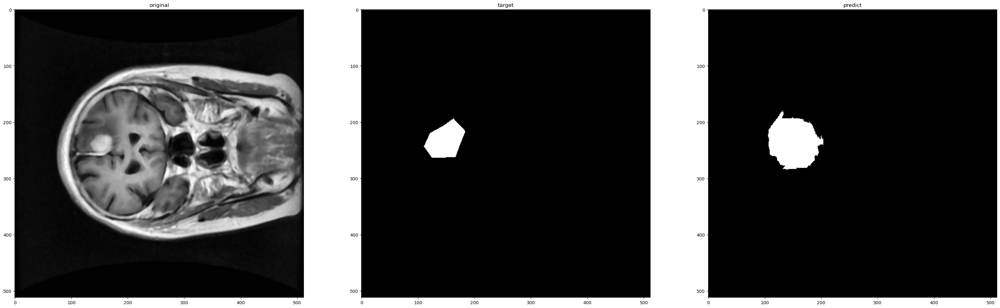

第9轮次已训练300批样本, 本批次平均loss值: 0.3415915706753731
第9轮次已训练600批样本, 本批次平均loss值: 0.34113787770271303
第9轮次已训练900批样本, 本批次平均loss值: 0.3359539606173833
第9轮次已训练1200批样本, 本批次平均loss值: 0.3387769397099813
第9轮次已训练1500批样本, 本批次平均loss值: 0.33866106043259303
第9轮次已训练1800批样本, 本批次平均loss值: 0.33951340486605963
第9轮次已训练2100批样本, 本批次平均loss值: 0.3396421109636625
第9轮次已训练2400批样本, 本批次平均loss值: 0.33789644837379457
第9轮次已训练2700批样本, 本批次平均loss值: 0.3352644278605779
current epoch average cross entropy loss: 0.37690550088882446
Dice score 0.7281778189395692


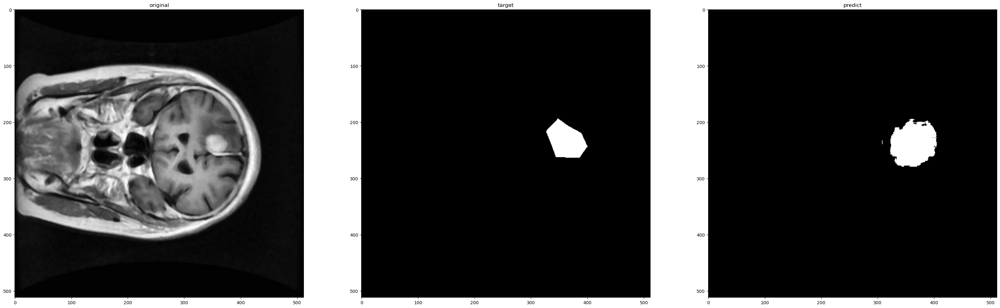

第10轮次已训练300批样本, 本批次平均loss值: 0.3362175359328588
第10轮次已训练600批样本, 本批次平均loss值: 0.33718889236450195
第10轮次已训练900批样本, 本批次平均loss值: 0.33500724534193677
第10轮次已训练1200批样本, 本批次平均loss值: 0.3379611430565516
第10轮次已训练1500批样本, 本批次平均loss值: 0.33575900932153063
第10轮次已训练1800批样本, 本批次平均loss值: 0.3374501469731331
第10轮次已训练2100批样本, 本批次平均loss值: 0.3387289532025655
第10轮次已训练2400批样本, 本批次平均loss值: 0.33743662148714065
第10轮次已训练2700批样本, 本批次平均loss值: 0.3346107358733813
current epoch average cross entropy loss: 0.3785104751586914
Dice score 0.7338997660386651


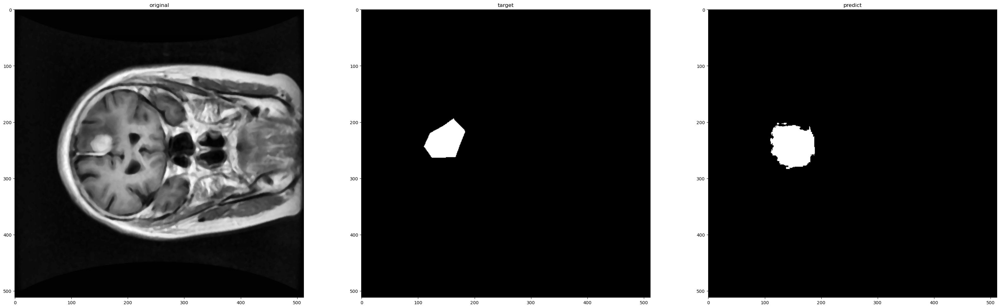

第11轮次已训练300批样本, 本批次平均loss值: 0.33542189210653306
第11轮次已训练600批样本, 本批次平均loss值: 0.33562254627545673
第11轮次已训练900批样本, 本批次平均loss值: 0.33464352518320084
第11轮次已训练1200批样本, 本批次平均loss值: 0.33540420889854433
第11轮次已训练1500批样本, 本批次平均loss值: 0.33866274654865264
第11轮次已训练1800批样本, 本批次平均loss值: 0.33606684813896814
第11轮次已训练2100批样本, 本批次平均loss值: 0.33748645017544426
第11轮次已训练2400批样本, 本批次平均loss值: 0.3367913317680359
第11轮次已训练2700批样本, 本批次平均loss值: 0.33491972158352534
current epoch average cross entropy loss: 0.3765103220939636
Dice score 0.7284430140938851


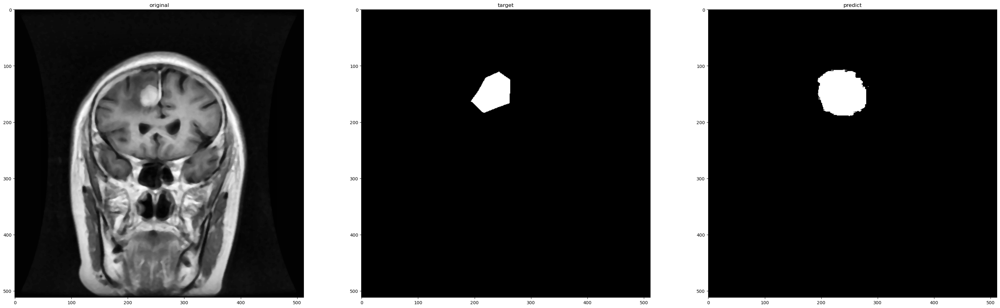

第12轮次已训练300批样本, 本批次平均loss值: 0.3321044956644376
第12轮次已训练600批样本, 本批次平均loss值: 0.3365534800291061
第12轮次已训练900批样本, 本批次平均loss值: 0.33475762844085694
第12轮次已训练1200批样本, 本批次平均loss值: 0.33673772275447844
第12轮次已训练1500批样本, 本批次平均loss值: 0.337486718694369
第12轮次已训练1800批样本, 本批次平均loss值: 0.3327658923467
第12轮次已训练2100批样本, 本批次平均loss值: 0.33520804991324743
第12轮次已训练2400批样本, 本批次平均loss值: 0.3384333523114522
第12轮次已训练2700批样本, 本批次平均loss值: 0.3356242144107819
current epoch average cross entropy loss: 0.37329569458961487
Dice score 0.745017182130584


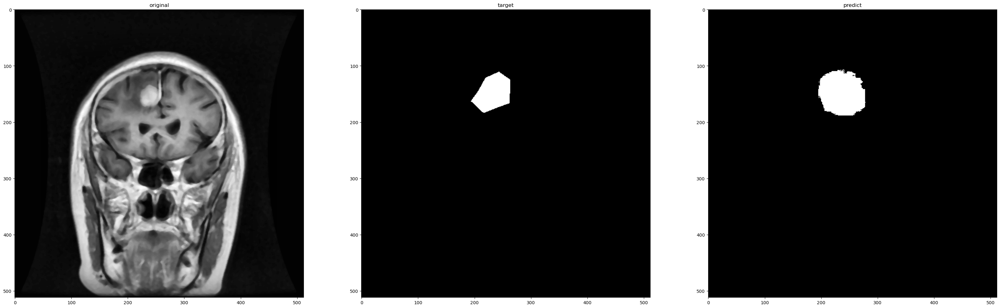

第13轮次已训练300批样本, 本批次平均loss值: 0.3338317135969798
第13轮次已训练600批样本, 本批次平均loss值: 0.3339754621187846
第13轮次已训练900批样本, 本批次平均loss值: 0.33609556247790656
第13轮次已训练1200批样本, 本批次平均loss值: 0.33595943957567215
第13轮次已训练1500批样本, 本批次平均loss值: 0.3360611836115519
第13轮次已训练1800批样本, 本批次平均loss值: 0.3337164173523585
第13轮次已训练2100批样本, 本批次平均loss值: 0.33618508954842885
第13轮次已训练2400批样本, 本批次平均loss值: 0.3335983710487684
第13轮次已训练2700批样本, 本批次平均loss值: 0.3363125942150752
current epoch average cross entropy loss: 0.3731834888458252
Dice score 0.7491942222752774


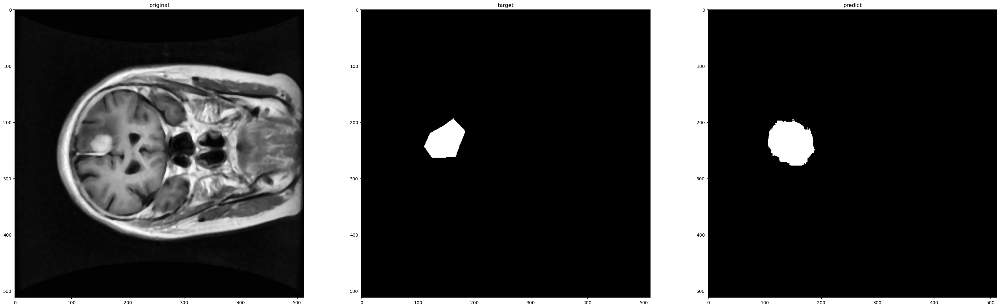

第14轮次已训练300批样本, 本批次平均loss值: 0.3345010659098625
第14轮次已训练600批样本, 本批次平均loss值: 0.33480836043755213
第14轮次已训练900批样本, 本批次平均loss值: 0.33588634451230365
第14轮次已训练1200批样本, 本批次平均loss值: 0.33410107423861823
第14轮次已训练1500批样本, 本批次平均loss值: 0.33580234736204145
第14轮次已训练1800批样本, 本批次平均loss值: 0.33359510034322737
第14轮次已训练2100批样本, 本批次平均loss值: 0.33305547426144283
第14轮次已训练2400批样本, 本批次平均loss值: 0.33388707200686135
第14轮次已训练2700批样本, 本批次平均loss值: 0.3341784555713336
current epoch average cross entropy loss: 0.37108442187309265
Dice score 0.7871331539151607


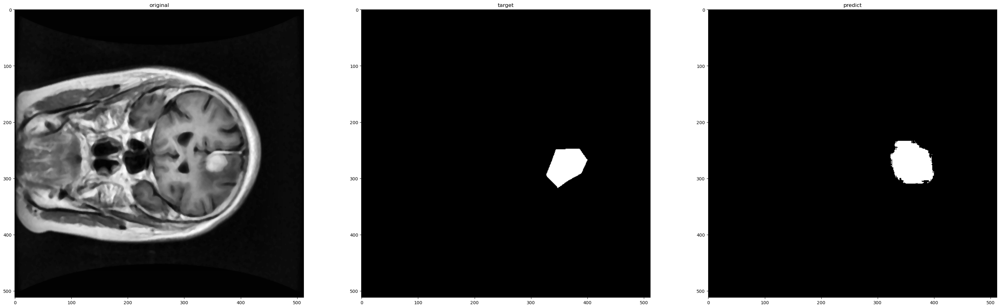

第15轮次已训练300批样本, 本批次平均loss值: 0.3347053425510724
第15轮次已训练600批样本, 本批次平均loss值: 0.3339920862515767
第15轮次已训练900批样本, 本批次平均loss值: 0.33431852996349337
第15轮次已训练1200批样本, 本批次平均loss值: 0.3332514825463295
第15轮次已训练1500批样本, 本批次平均loss值: 0.33697591712077457
第15轮次已训练1800批样本, 本批次平均loss值: 0.3349779043594996
第15轮次已训练2100批样本, 本批次平均loss值: 0.3345805889368057
第15轮次已训练2400批样本, 本批次平均loss值: 0.33295204788446425
第15轮次已训练2700批样本, 本批次平均loss值: 0.3309208040436109
current epoch average cross entropy loss: 0.37240853905677795
Dice score 0.7773671466802599


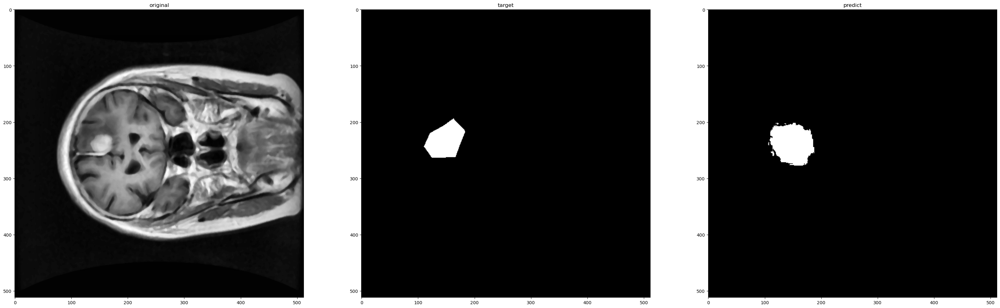

第16轮次已训练300批样本, 本批次平均loss值: 0.3337793269753456
第16轮次已训练600批样本, 本批次平均loss值: 0.3332986451188723
第16轮次已训练900批样本, 本批次平均loss值: 0.3352373522520065
第16轮次已训练1200批样本, 本批次平均loss值: 0.3347582777341207
第16轮次已训练1500批样本, 本批次平均loss值: 0.3322991207242012
第16轮次已训练1800批样本, 本批次平均loss值: 0.33417837222417196
第16轮次已训练2100批样本, 本批次平均loss值: 0.3330979504187902
第16轮次已训练2400批样本, 本批次平均loss值: 0.3325568889578184
第16轮次已训练2700批样本, 本批次平均loss值: 0.33398213734229404
current epoch average cross entropy loss: 0.3719951808452606
Dice score 0.8201581027667983


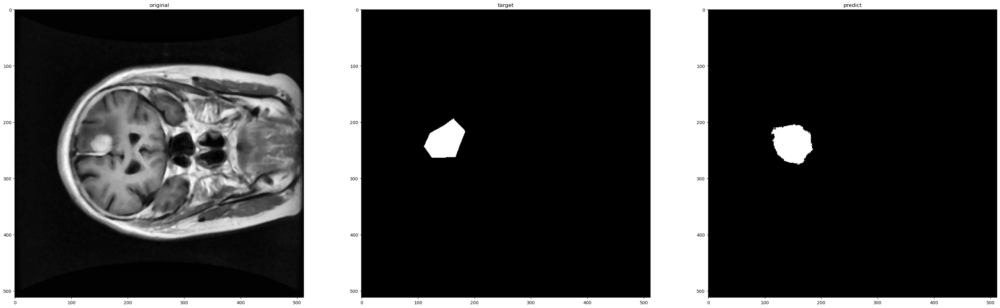

第17轮次已训练300批样本, 本批次平均loss值: 0.329386811653773
第17轮次已训练600批样本, 本批次平均loss值: 0.33358699490626653
第17轮次已训练900批样本, 本批次平均loss值: 0.3333585810661316
第17轮次已训练1200批样本, 本批次平均loss值: 0.3344962607820829
第17轮次已训练1500批样本, 本批次平均loss值: 0.3336329182982445
第17轮次已训练1800批样本, 本批次平均loss值: 0.33322637965281804
第17轮次已训练2100批样本, 本批次平均loss值: 0.33046006739139555
第17轮次已训练2400批样本, 本批次平均loss值: 0.3347104536493619
第17轮次已训练2700批样本, 本批次平均loss值: 0.3353174610932668
current epoch average cross entropy loss: 0.36814746260643005
Dice score 0.8122259136212624


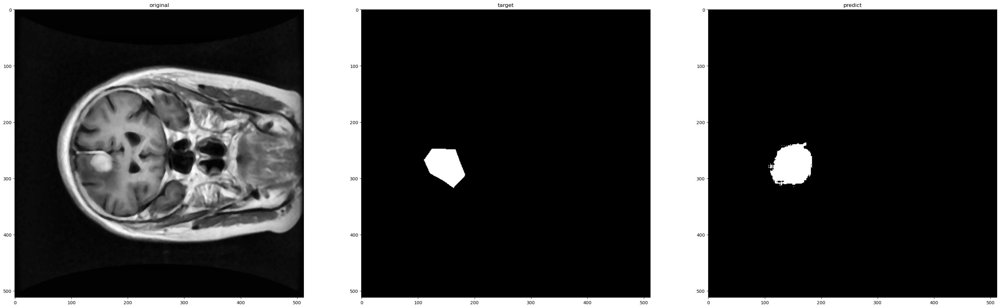

第18轮次已训练300批样本, 本批次平均loss值: 0.3323808093865713
第18轮次已训练600批样本, 本批次平均loss值: 0.33051973988612493
第18轮次已训练900批样本, 本批次平均loss值: 0.3307544955611229
第18轮次已训练1200批样本, 本批次平均loss值: 0.33366854856411615
第18轮次已训练1500批样本, 本批次平均loss值: 0.3317736687262853
第18轮次已训练1800批样本, 本批次平均loss值: 0.33669338285923006
第18轮次已训练2100批样本, 本批次平均loss值: 0.332019133468469
第18轮次已训练2400批样本, 本批次平均loss值: 0.33544598509867984
第18轮次已训练2700批样本, 本批次平均loss值: 0.3338916673262914
current epoch average cross entropy loss: 0.3674904406070709
Dice score 0.7546156428331654


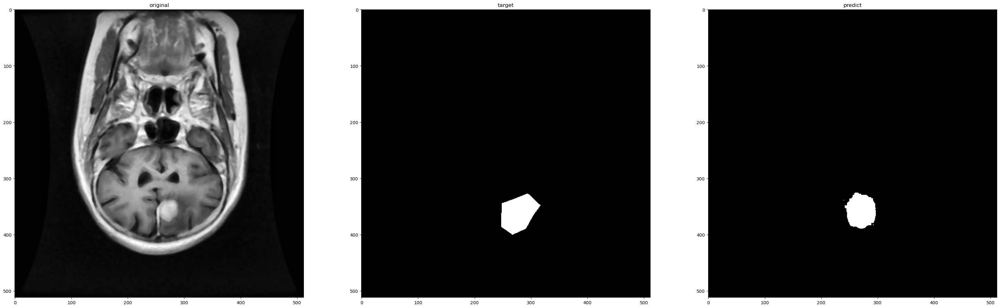

第19轮次已训练300批样本, 本批次平均loss值: 0.33358606884876885
第19轮次已训练600批样本, 本批次平均loss值: 0.3299324600895246
第19轮次已训练900批样本, 本批次平均loss值: 0.33220593611399335
第19轮次已训练1200批样本, 本批次平均loss值: 0.3313973805308342
第19轮次已训练1500批样本, 本批次平均loss值: 0.33291019350290296
第19轮次已训练1800批样本, 本批次平均loss值: 0.33217951079209646
第19轮次已训练2100批样本, 本批次平均loss值: 0.33455490271250404
第19轮次已训练2400批样本, 本批次平均loss值: 0.33025682002305984
第19轮次已训练2700批样本, 本批次平均loss值: 0.33645770778258643
current epoch average cross entropy loss: 0.3726990520954132
Dice score 0.8442979169788699


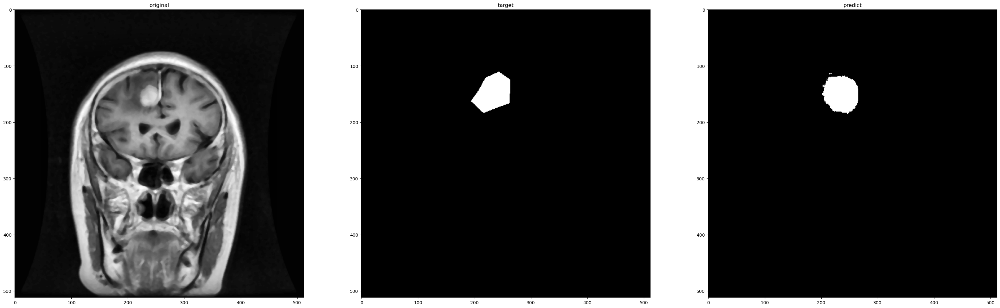

第20轮次已训练300批样本, 本批次平均loss值: 0.33209505637486775
第20轮次已训练600批样本, 本批次平均loss值: 0.33428982843955357
第20轮次已训练900批样本, 本批次平均loss值: 0.3318282381693522
第20轮次已训练1200批样本, 本批次平均loss值: 0.3317729601264
第20轮次已训练1500批样本, 本批次平均loss值: 0.3337196092804273
第20轮次已训练1800批样本, 本批次平均loss值: 0.32943343033393224
第20轮次已训练2100批样本, 本批次平均loss值: 0.3335075417160988
第20轮次已训练2400批样本, 本批次平均loss值: 0.32974016547203067
第20轮次已训练2700批样本, 本批次平均loss值: 0.3333569108446439
current epoch average cross entropy loss: 0.3693114221096039
Dice score 0.7317298797409805


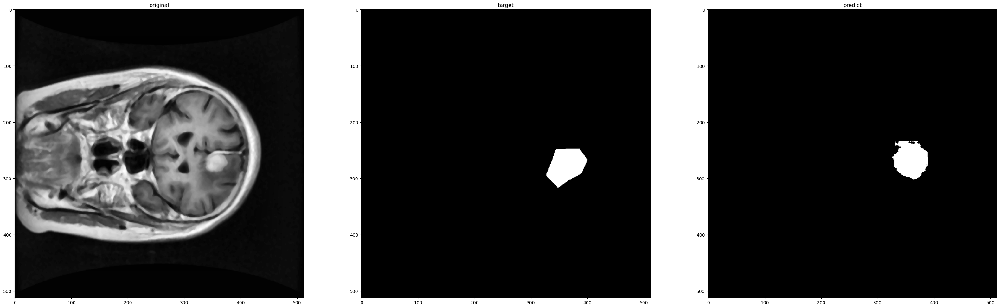

第21轮次已训练300批样本, 本批次平均loss值: 0.33172077099482217
第21轮次已训练600批样本, 本批次平均loss值: 0.3325552933414777
第21轮次已训练900批样本, 本批次平均loss值: 0.32931809743245444
第21轮次已训练1200批样本, 本批次平均loss值: 0.3311199605464935
第21轮次已训练1500批样本, 本批次平均loss值: 0.3343093385299047
第21轮次已训练1800批样本, 本批次平均loss值: 0.33160997291405997
第21轮次已训练2100批样本, 本批次平均loss值: 0.33303172131379444
第21轮次已训练2400批样本, 本批次平均loss值: 0.33386510014534
第21轮次已训练2700批样本, 本批次平均loss值: 0.33116078714529673
current epoch average cross entropy loss: 0.36608147621154785
Dice score 0.798491040553285


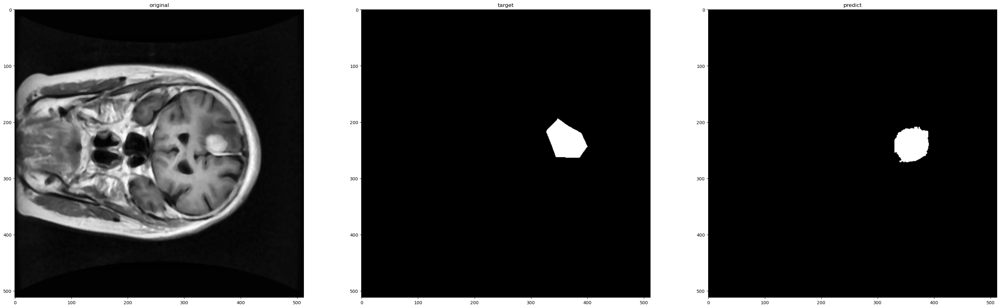

第22轮次已训练300批样本, 本批次平均loss值: 0.3302776143948237
第22轮次已训练600批样本, 本批次平均loss值: 0.3307304405172666
第22轮次已训练900批样本, 本批次平均loss值: 0.3299614746371905
第22轮次已训练1200批样本, 本批次平均loss值: 0.33417853941520054
第22轮次已训练1500批样本, 本批次平均loss值: 0.33363233268260956
第22轮次已训练1800批样本, 本批次平均loss值: 0.3317388117313385
第22轮次已训练2100批样本, 本批次平均loss值: 0.32962386240561803
第22轮次已训练2400批样本, 本批次平均loss值: 0.3317177464564641
第22轮次已训练2700批样本, 本批次平均loss值: 0.3326877949635188
current epoch average cross entropy loss: 0.3656427264213562
Dice score 0.8126942581383935


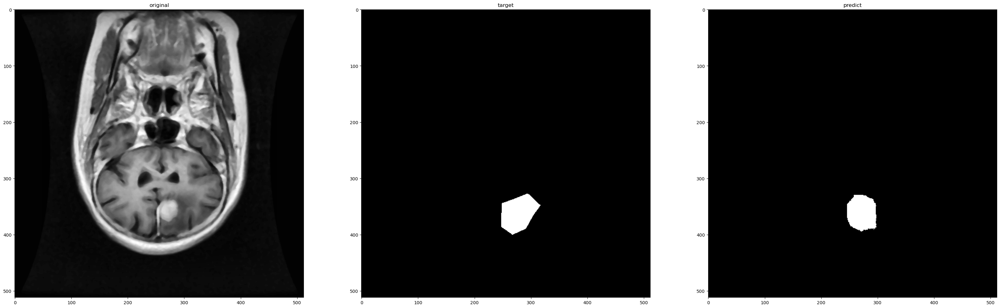

第23轮次已训练300批样本, 本批次平均loss值: 0.3332199118534724
第23轮次已训练600批样本, 本批次平均loss值: 0.33080367515484493
第23轮次已训练900批样本, 本批次平均loss值: 0.3317679539322853
第23轮次已训练1200批样本, 本批次平均loss值: 0.33039951264858247
第23轮次已训练1500批样本, 本批次平均loss值: 0.33274525026480356
第23轮次已训练1800批样本, 本批次平均loss值: 0.3302502050995827
第23轮次已训练2100批样本, 本批次平均loss值: 0.3308775316675504
第23轮次已训练2400批样本, 本批次平均loss值: 0.33178366074959437
第23轮次已训练2700批样本, 本批次平均loss值: 0.3306148162484169
current epoch average cross entropy loss: 0.36484071612358093
Dice score 0.8265648854961831


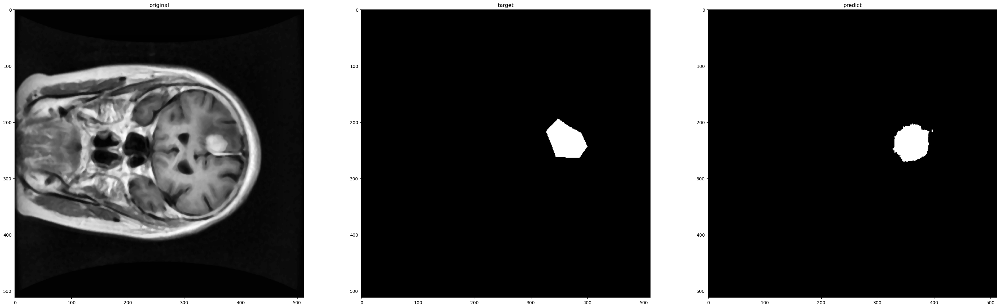

第24轮次已训练300批样本, 本批次平均loss值: 0.3301793052752813
第24轮次已训练600批样本, 本批次平均loss值: 0.3313564924399058
第24轮次已训练900批样本, 本批次平均loss值: 0.3305130342642466
第24轮次已训练1200批样本, 本批次平均loss值: 0.3321811835964521
第24轮次已训练1500批样本, 本批次平均loss值: 0.3314416073759397
第24轮次已训练1800批样本, 本批次平均loss值: 0.3319606575369835
第24轮次已训练2100批样本, 本批次平均loss值: 0.33264872173468274
第24轮次已训练2400批样本, 本批次平均loss值: 0.33103935490051906
第24轮次已训练2700批样本, 本批次平均loss值: 0.33009178002675377
current epoch average cross entropy loss: 0.36549314856529236
Dice score 0.7590340208002819


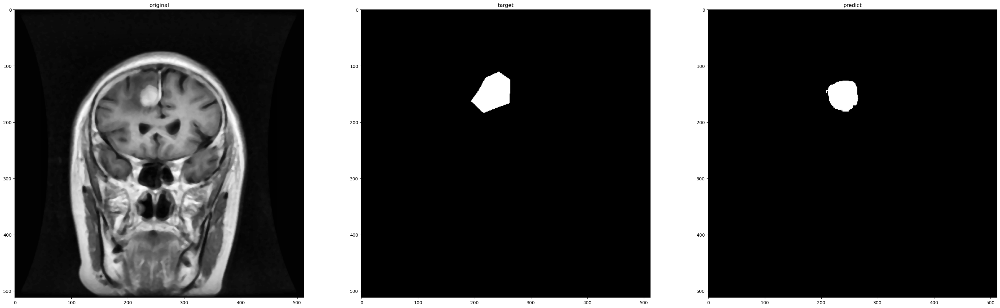

第25轮次已训练300批样本, 本批次平均loss值: 0.33095951040585836
第25轮次已训练600批样本, 本批次平均loss值: 0.33048201352357864
第25轮次已训练900批样本, 本批次平均loss值: 0.3297202070554098
第25轮次已训练1200批样本, 本批次平均loss值: 0.33008897105852764
第25轮次已训练1500批样本, 本批次平均loss值: 0.33105566948652265
第25轮次已训练1800批样本, 本批次平均loss值: 0.3318822095791499
第25轮次已训练2100批样本, 本批次平均loss值: 0.3323438406984011
第25轮次已训练2400批样本, 本批次平均loss值: 0.32959523648023603
第25轮次已训练2700批样本, 本批次平均loss值: 0.3305319920182228
current epoch average cross entropy loss: 0.3693390190601349
Dice score 0.7206634903829185


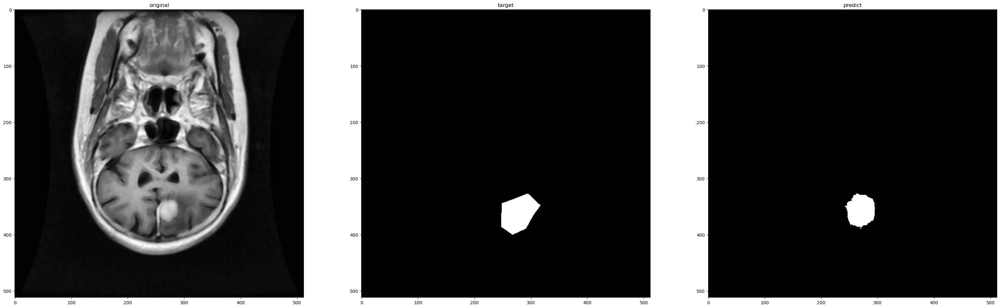

第26轮次已训练300批样本, 本批次平均loss值: 0.32829892784357073
第26轮次已训练600批样本, 本批次平均loss值: 0.33379558722178143
第26轮次已训练900批样本, 本批次平均loss值: 0.32966313858826957
第26轮次已训练1200批样本, 本批次平均loss值: 0.3307763662934303
第26轮次已训练1500批样本, 本批次平均loss值: 0.33076866865158083
第26轮次已训练1800批样本, 本批次平均loss值: 0.32992092152436575
第26轮次已训练2100批样本, 本批次平均loss值: 0.33448394417762756
第26轮次已训练2400批样本, 本批次平均loss值: 0.32933880855639774
第26轮次已训练2700批样本, 本批次平均loss值: 0.33058180669943493
current epoch average cross entropy loss: 0.3666298985481262
Dice score 0.7621301775147928


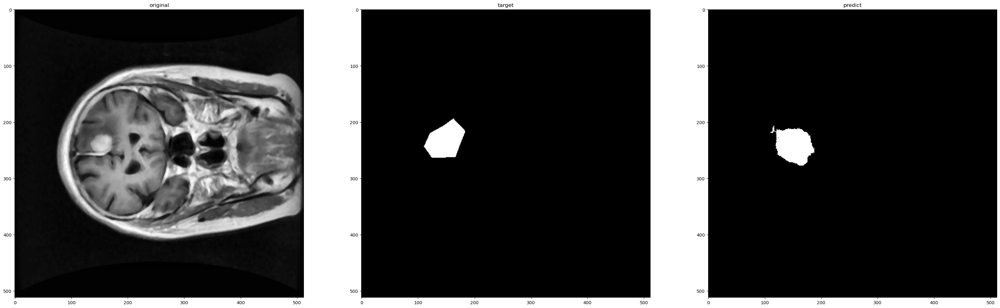

第27轮次已训练300批样本, 本批次平均loss值: 0.3294437474012375
第27轮次已训练600批样本, 本批次平均loss值: 0.33104735185702644
第27轮次已训练900批样本, 本批次平均loss值: 0.3318449370066325
第27轮次已训练1200批样本, 本批次平均loss值: 0.3269993030031522
第27轮次已训练1500批样本, 本批次平均loss值: 0.33032165726025897
第27轮次已训练1800批样本, 本批次平均loss值: 0.32982049067815145
第27轮次已训练2100批样本, 本批次平均loss值: 0.33120947986841204
第27轮次已训练2400批样本, 本批次平均loss值: 0.32902736961841583
第27轮次已训练2700批样本, 本批次平均loss值: 0.3299975381294886
current epoch average cross entropy loss: 0.36803683638572693
Dice score 0.8153276445016905


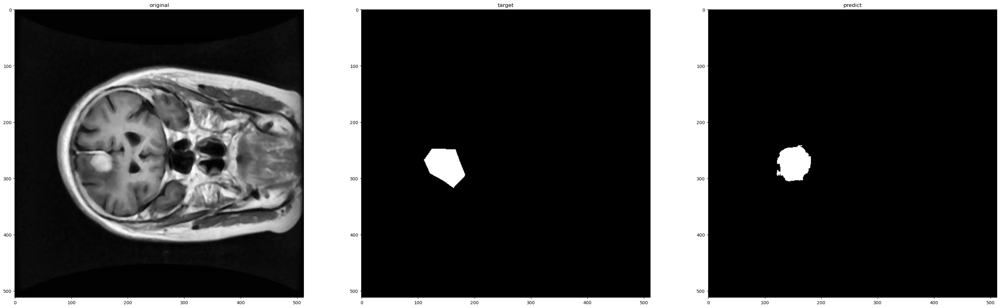

第28轮次已训练300批样本, 本批次平均loss值: 0.33137834529081983
第28轮次已训练600批样本, 本批次平均loss值: 0.32940520634253817
第28轮次已训练900批样本, 本批次平均loss值: 0.32882305880387624
第28轮次已训练1200批样本, 本批次平均loss值: 0.32948430587848027
第28轮次已训练1500批样本, 本批次平均loss值: 0.32591993192831675
第28轮次已训练1800批样本, 本批次平均loss值: 0.3293355588118235
第28轮次已训练2100批样本, 本批次平均loss值: 0.3313522708415985
第28轮次已训练2400批样本, 本批次平均loss值: 0.3300807304183642
第28轮次已训练2700批样本, 本批次平均loss值: 0.33217207829157513
current epoch average cross entropy loss: 0.3669639229774475
Dice score 0.7844392051195688


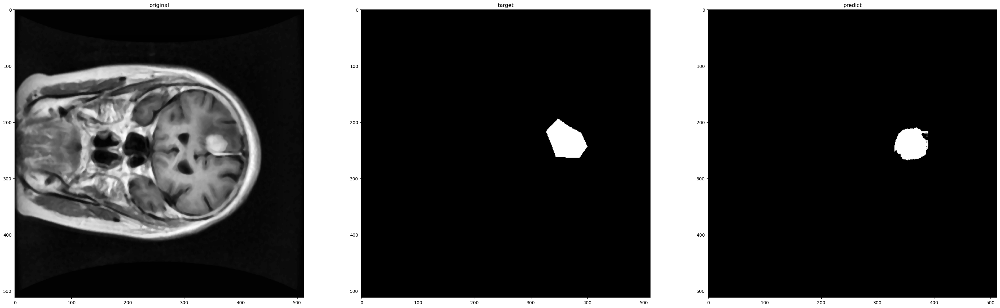

第29轮次已训练300批样本, 本批次平均loss值: 0.32742554903030396
第29轮次已训练600批样本, 本批次平均loss值: 0.328717300593853
第29轮次已训练900批样本, 本批次平均loss值: 0.32905591507752735
第29轮次已训练1200批样本, 本批次平均loss值: 0.330249999264876
第29轮次已训练1500批样本, 本批次平均loss值: 0.3292777746915817
第29轮次已训练1800批样本, 本批次平均loss值: 0.33004419565200804
第29轮次已训练2100批样本, 本批次平均loss值: 0.32853082358837127
第29轮次已训练2400批样本, 本批次平均loss值: 0.3305487012863159
第29轮次已训练2700批样本, 本批次平均loss值: 0.33133239646752677
current epoch average cross entropy loss: 0.3660438656806946
Dice score 0.8273761820804615


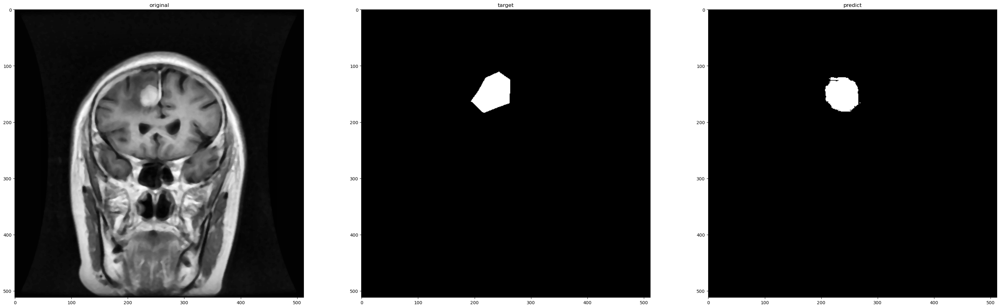

第30轮次已训练300批样本, 本批次平均loss值: 0.32765874723593397
第30轮次已训练600批样本, 本批次平均loss值: 0.3298359348376592
第30轮次已训练900批样本, 本批次平均loss值: 0.33012917220592497
第30轮次已训练1200批样本, 本批次平均loss值: 0.3304083424806595
第30轮次已训练1500批样本, 本批次平均loss值: 0.32950304498275124
第30轮次已训练1800批样本, 本批次平均loss值: 0.33010595589876174
第30轮次已训练2100批样本, 本批次平均loss值: 0.32972690790891646
第30轮次已训练2400批样本, 本批次平均loss值: 0.3284036134680112
第30轮次已训练2700批样本, 本批次平均loss值: 0.33066058039665225
current epoch average cross entropy loss: 0.3667141795158386
Dice score 0.8081791626095423


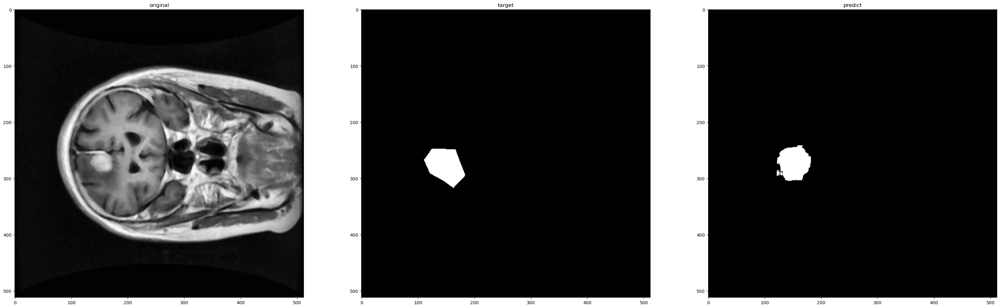

第31轮次已训练300批样本, 本批次平均loss值: 0.33167263875404995
第31轮次已训练600批样本, 本批次平均loss值: 0.3284320623675982
第31轮次已训练900批样本, 本批次平均loss值: 0.3303884772459666
第31轮次已训练1200批样本, 本批次平均loss值: 0.32831606090068816
第31轮次已训练1500批样本, 本批次平均loss值: 0.32983526269594826
第31轮次已训练1800批样本, 本批次平均loss值: 0.32867490539948147
第31轮次已训练2100批样本, 本批次平均loss值: 0.3298954216639201
第31轮次已训练2400批样本, 本批次平均loss值: 0.3296610846122106
第31轮次已训练2700批样本, 本批次平均loss值: 0.3295906232794126
current epoch average cross entropy loss: 0.3660699725151062
Dice score 0.8200714517700551


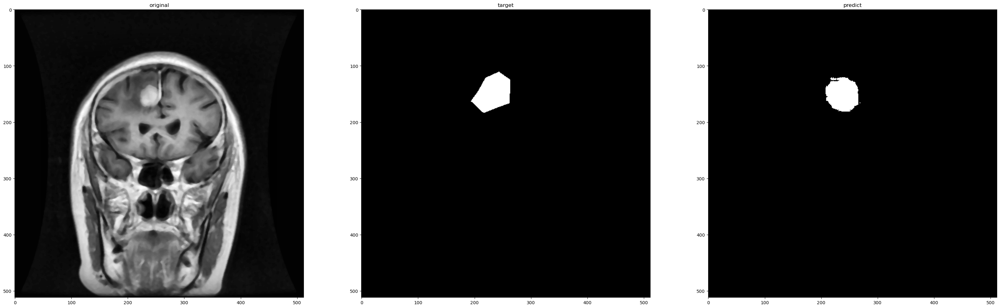

第32轮次已训练300批样本, 本批次平均loss值: 0.3279576357205709
第32轮次已训练600批样本, 本批次平均loss值: 0.33041336059570314
第32轮次已训练900批样本, 本批次平均loss值: 0.3280659173925718
第32轮次已训练1200批样本, 本批次平均loss值: 0.32904422531525296
第32轮次已训练1500批样本, 本批次平均loss值: 0.3293584206700325
第32轮次已训练1800批样本, 本批次平均loss值: 0.3304715794324875
第32轮次已训练2100批样本, 本批次平均loss值: 0.32971739490826923
第32轮次已训练2400批样本, 本批次平均loss值: 0.33247252414623896
第32轮次已训练2700批样本, 本批次平均loss值: 0.3292376144727071
current epoch average cross entropy loss: 0.3670080304145813
Dice score 0.7162334121068895


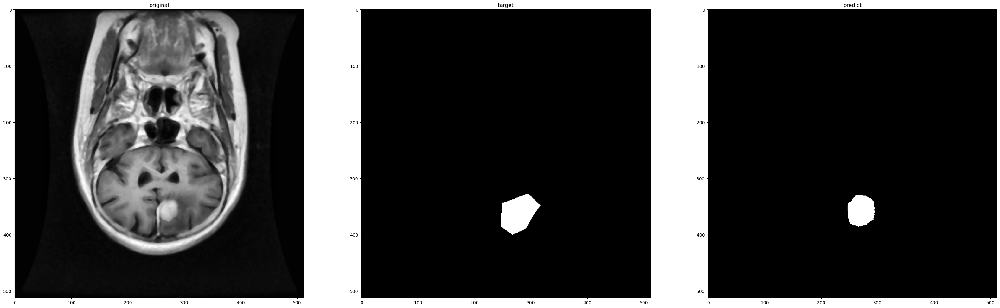

第33轮次已训练300批样本, 本批次平均loss值: 0.32941981186469393
第33轮次已训练600批样本, 本批次平均loss值: 0.3288414925336838
第33轮次已训练900批样本, 本批次平均loss值: 0.3318856547276179
第33轮次已训练1200批样本, 本批次平均loss值: 0.3290089730421702
第33轮次已训练1500批样本, 本批次平均loss值: 0.3291519835591316
第33轮次已训练1800批样本, 本批次平均loss值: 0.3285722697774569
第33轮次已训练2100批样本, 本批次平均loss值: 0.3275765090187391
第33轮次已训练2400批样本, 本批次平均loss值: 0.32948798457781475
第33轮次已训练2700批样本, 本批次平均loss值: 0.3306051610906919
current epoch average cross entropy loss: 0.36740729212760925
Dice score 0.7323001056710108


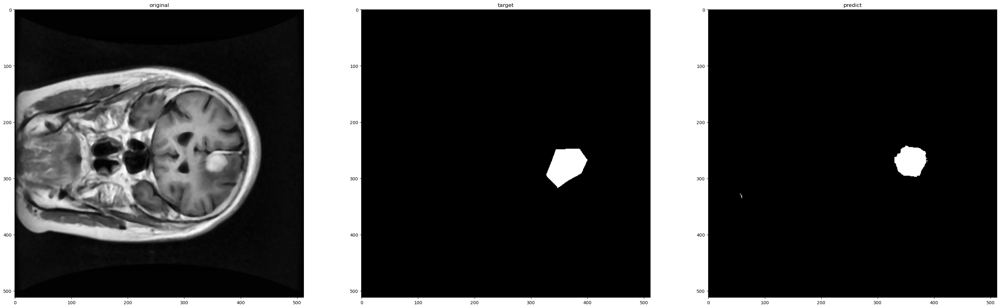

第34轮次已训练300批样本, 本批次平均loss值: 0.33007187753915784
第34轮次已训练600批样本, 本批次平均loss值: 0.3284502590696017
第34轮次已训练900批样本, 本批次平均loss值: 0.3292215569814046
第34轮次已训练1200批样本, 本批次平均loss值: 0.32831563502550126
第34轮次已训练1500批样本, 本批次平均loss值: 0.32896911551554997
第34轮次已训练1800批样本, 本批次平均loss值: 0.3337047306696574
第34轮次已训练2100批样本, 本批次平均loss值: 0.3297141497333845
第34轮次已训练2400批样本, 本批次平均loss值: 0.3293154414494832
第34轮次已训练2700批样本, 本批次平均loss值: 0.3285146722197533
current epoch average cross entropy loss: 0.3676375150680542
Dice score 0.8020901371652513


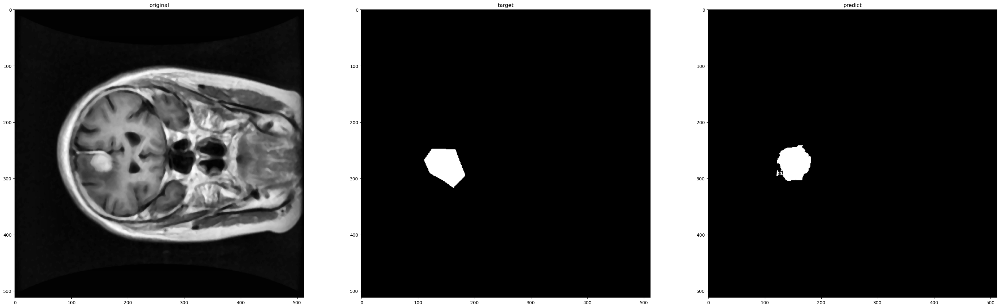

第35轮次已训练300批样本, 本批次平均loss值: 0.3285216694076856
第35轮次已训练600批样本, 本批次平均loss值: 0.33053480754295983
第35轮次已训练900批样本, 本批次平均loss值: 0.3282191488146782
第35轮次已训练1200批样本, 本批次平均loss值: 0.3322847323616346
第35轮次已训练1500批样本, 本批次平均loss值: 0.3293526041507721
第35轮次已训练1800批样本, 本批次平均loss值: 0.32748764246702194
第35轮次已训练2100批样本, 本批次平均loss值: 0.32941483944654465
第35轮次已训练2400批样本, 本批次平均loss值: 0.3296775781114896
第35轮次已训练2700批样本, 本批次平均loss值: 0.330065646469593
current epoch average cross entropy loss: 0.3670806884765625
Dice score 0.816506279562877


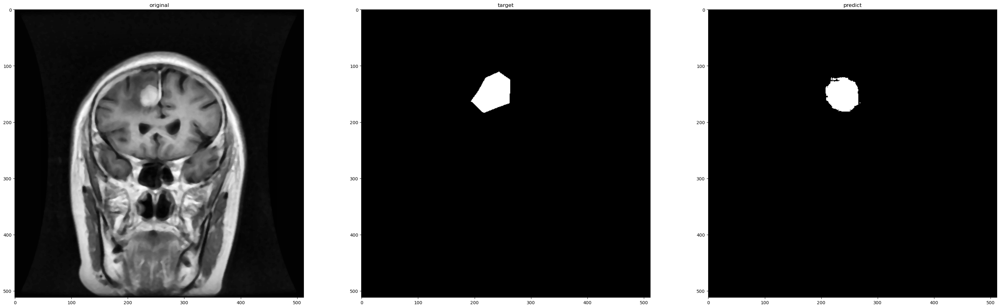

第36轮次已训练300批样本, 本批次平均loss值: 0.3282970597346624
第36轮次已训练600批样本, 本批次平均loss值: 0.329969285428524
第36轮次已训练900批样本, 本批次平均loss值: 0.3309576097130775
第36轮次已训练1200批样本, 本批次平均loss值: 0.3301467436552048
第36轮次已训练1500批样本, 本批次平均loss值: 0.3302202394604683
第36轮次已训练1800批样本, 本批次平均loss值: 0.32826331903537115
第36轮次已训练2100批样本, 本批次平均loss值: 0.32835365464289984
第36轮次已训练2400批样本, 本批次平均loss值: 0.3278569689393043
第36轮次已训练2700批样本, 本批次平均loss值: 0.3302635645866394
current epoch average cross entropy loss: 0.36659106612205505
Dice score 0.8020901371652513


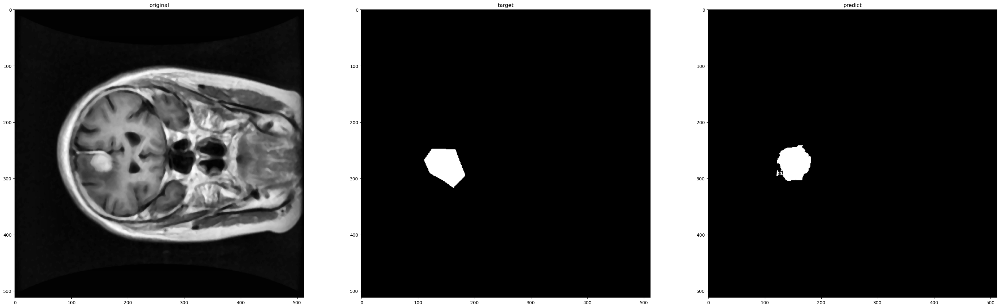

第37轮次已训练300批样本, 本批次平均loss值: 0.32875303049882254
第37轮次已训练600批样本, 本批次平均loss值: 0.329356027841568
第37轮次已训练900批样本, 本批次平均loss值: 0.3299238913257917
第37轮次已训练1200批样本, 本批次平均loss值: 0.33070361534754433
第37轮次已训练1500批样本, 本批次平均loss值: 0.3297827848792076
第37轮次已训练1800批样本, 本批次平均loss值: 0.3296760337551435
第37轮次已训练2100批样本, 本批次平均loss值: 0.3293490810195605
第37轮次已训练2400批样本, 本批次平均loss值: 0.33075866450866065
第37轮次已训练2700批样本, 本批次平均loss值: 0.32839472889900206
current epoch average cross entropy loss: 0.36610642075538635
Dice score 0.7324290998766954


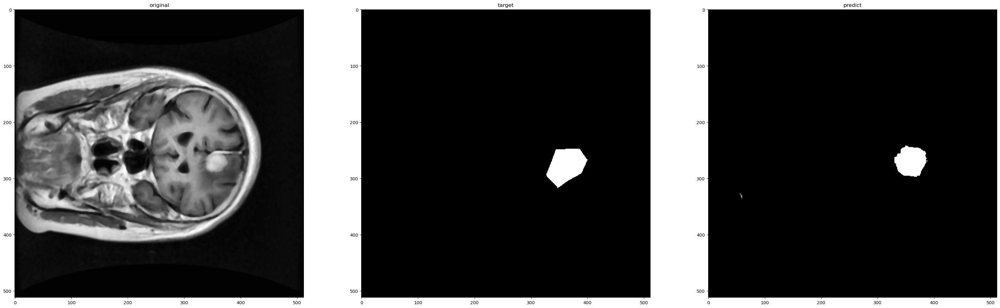

第38轮次已训练300批样本, 本批次平均loss值: 0.3299101663629214
第38轮次已训练600批样本, 本批次平均loss值: 0.3301302423079809
第38轮次已训练900批样本, 本批次平均loss值: 0.32704162687063215
第38轮次已训练1200批样本, 本批次平均loss值: 0.3287822950879733
第38轮次已训练1500批样本, 本批次平均loss值: 0.329937545756499
第38轮次已训练1800批样本, 本批次平均loss值: 0.3324528701106707
第38轮次已训练2100批样本, 本批次平均loss值: 0.3299544308582942
第38轮次已训练2400批样本, 本批次平均loss值: 0.32999767164389293
第38轮次已训练2700批样本, 本批次平均loss值: 0.32882214764753975
current epoch average cross entropy loss: 0.36640968918800354
Dice score 0.7152992541386209


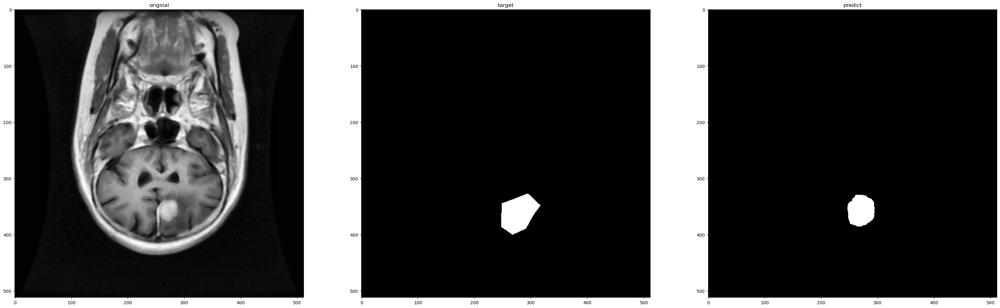

第39轮次已训练300批样本, 本批次平均loss值: 0.3289159936706225
第39轮次已训练600批样本, 本批次平均loss值: 0.3297219262520472
第39轮次已训练900批样本, 本批次平均loss值: 0.33160194089015327
第39轮次已训练1200批样本, 本批次平均loss值: 0.33021454016367596
第39轮次已训练1500批样本, 本批次平均loss值: 0.32872833440701166
第39轮次已训练1800批样本, 本批次平均loss值: 0.3294874307513237
第39轮次已训练2100批样本, 本批次平均loss值: 0.328887403011322
第39轮次已训练2400批样本, 本批次平均loss值: 0.32857521533966066
第39轮次已训练2700批样本, 本批次平均loss值: 0.3289835574229558
current epoch average cross entropy loss: 0.3671233355998993
Dice score 0.7152992541386209


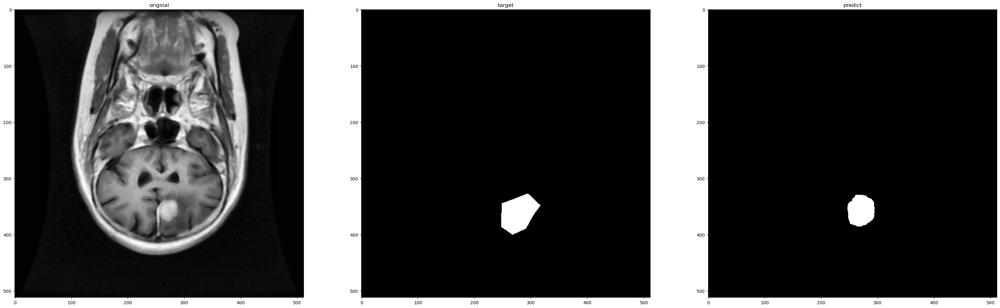

第40轮次已训练300批样本, 本批次平均loss值: 0.327537373205026
第40轮次已训练600批样本, 本批次平均loss值: 0.333930883705616
第40轮次已训练900批样本, 本批次平均loss值: 0.3282353245218595
第40轮次已训练1200批样本, 本批次平均loss值: 0.3309614031513532
第40轮次已训练1500批样本, 本批次平均loss值: 0.3279638981819153
第40轮次已训练1800批样本, 本批次平均loss值: 0.32898782233397167
第40轮次已训练2100批样本, 本批次平均loss值: 0.33022509147723517
第40轮次已训练2400批样本, 本批次平均loss值: 0.32912287573019666
第40轮次已训练2700批样本, 本批次平均loss值: 0.328066928088665
current epoch average cross entropy loss: 0.36663588881492615
Dice score 0.8018944961620119


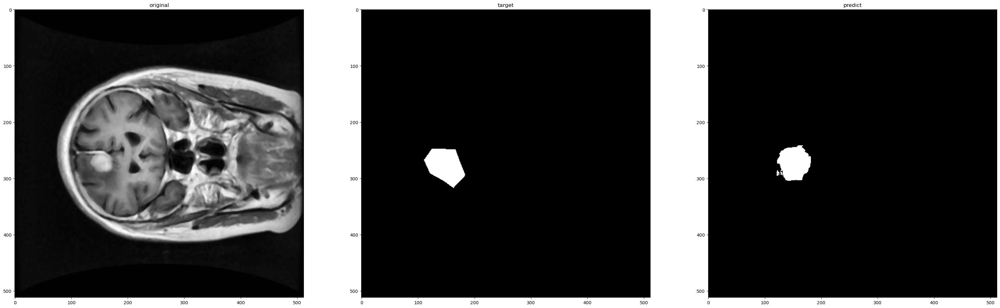

第41轮次已训练300批样本, 本批次平均loss值: 0.3296224355697632
第41轮次已训练600批样本, 本批次平均loss值: 0.3271406998236974
第41轮次已训练900批样本, 本批次平均loss值: 0.329532643755277
第41轮次已训练1200批样本, 本批次平均loss值: 0.3291851956645648
第41轮次已训练1500批样本, 本批次平均loss值: 0.32872365206480025
第41轮次已训练1800批样本, 本批次平均loss值: 0.3301866924762726
第41轮次已训练2100批样本, 本批次平均loss值: 0.33128295083840686
第41轮次已训练2400批样本, 本批次平均loss值: 0.33100075215101243
第41轮次已训练2700批样本, 本批次平均loss值: 0.3282400796810786
current epoch average cross entropy loss: 0.36658746004104614
Dice score 0.8018944961620119


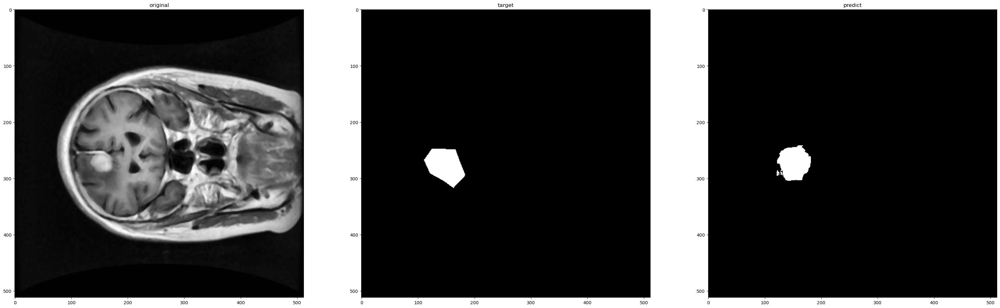

第42轮次已训练300批样本, 本批次平均loss值: 0.3292038972179095
第42轮次已训练600批样本, 本批次平均loss值: 0.33079053461551666
第42轮次已训练900批样本, 本批次平均loss值: 0.3295629793405533
第42轮次已训练1200批样本, 本批次平均loss值: 0.32996573984622957
第42轮次已训练1500批样本, 本批次平均loss值: 0.33071673214435576
第42轮次已训练1800批样本, 本批次平均loss值: 0.32982357929150263
第42轮次已训练2100批样本, 本批次平均loss值: 0.32795423328876494
第42轮次已训练2400批样本, 本批次平均loss值: 0.32821619520584744
第42轮次已训练2700批样本, 本批次平均loss值: 0.32943140119314196
current epoch average cross entropy loss: 0.3666643500328064
Dice score 0.816699282452707


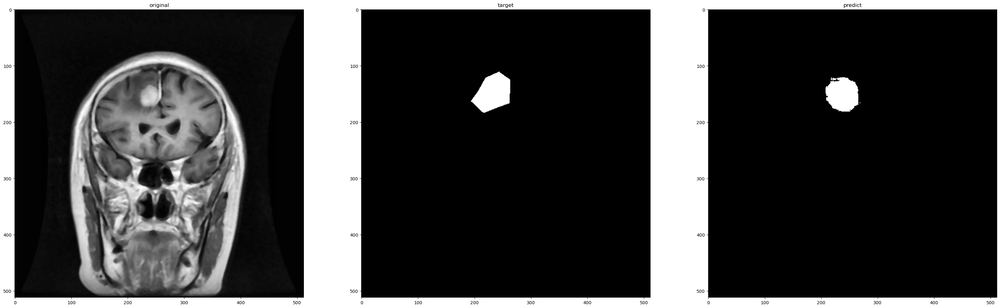

第43轮次已训练300批样本, 本批次平均loss值: 0.33090882768233615
第43轮次已训练600批样本, 本批次平均loss值: 0.33090171913305916
第43轮次已训练900批样本, 本批次平均loss值: 0.32952218532562255
第43轮次已训练1200批样本, 本批次平均loss值: 0.32986798296372094
第43轮次已训练1500批样本, 本批次平均loss值: 0.32968097120523454
第43轮次已训练1800批样本, 本批次平均loss值: 0.3289911125103633
第43轮次已训练2100批样本, 本批次平均loss值: 0.3274608931938807
第43轮次已训练2400批样本, 本批次平均loss值: 0.32711812525987627
第43轮次已训练2700批样本, 本批次平均loss值: 0.3291280125578245
current epoch average cross entropy loss: 0.36651626229286194
Dice score 0.7261528217080072


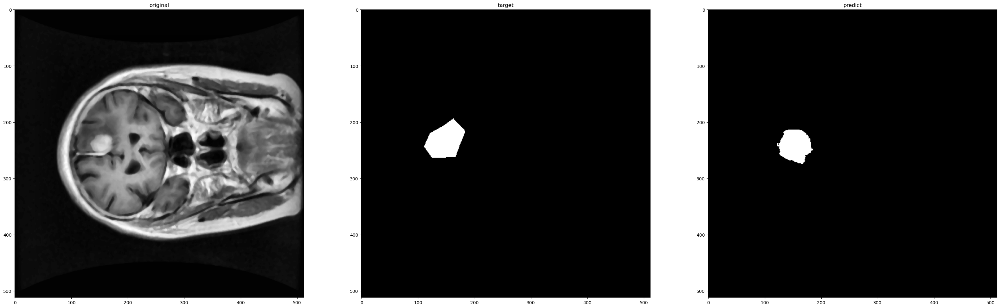

第44轮次已训练300批样本, 本批次平均loss值: 0.32656287888685864
第44轮次已训练600批样本, 本批次平均loss值: 0.33112323621908824
第44轮次已训练900批样本, 本批次平均loss值: 0.3299130602677663
第44轮次已训练1200批样本, 本批次平均loss值: 0.3298362155755361
第44轮次已训练1500批样本, 本批次平均loss值: 0.3287146071592967
第44轮次已训练1800批样本, 本批次平均loss值: 0.3307300370931625
第44轮次已训练2100批样本, 本批次平均loss值: 0.32957119107246396
第44轮次已训练2400批样本, 本批次平均loss值: 0.32933083673318225
第44轮次已训练2700批样本, 本批次平均loss值: 0.3288367930054665
current epoch average cross entropy loss: 0.36673370003700256
Dice score 0.715065502183406


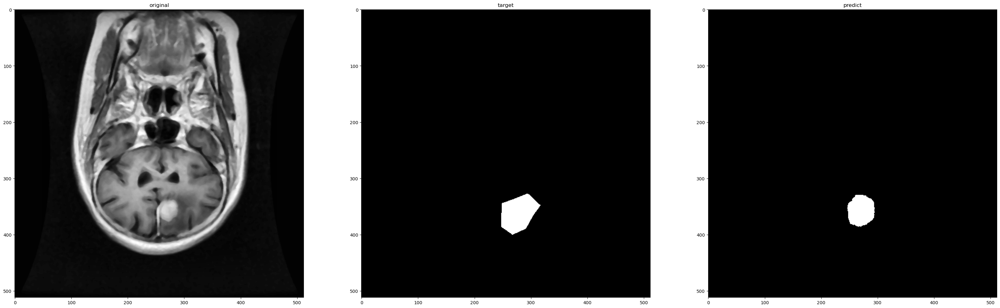

第45轮次已训练300批样本, 本批次平均loss值: 0.32815311739842096
第45轮次已训练600批样本, 本批次平均loss值: 0.3297666355967522
第45轮次已训练900批样本, 本批次平均loss值: 0.32884711742401124
第45轮次已训练1200批样本, 本批次平均loss值: 0.32935214738051094
第45轮次已训练1500批样本, 本批次平均loss值: 0.3292917989691099
第45轮次已训练1800批样本, 本批次平均loss值: 0.3291538887222608
第45轮次已训练2100批样本, 本批次平均loss值: 0.3295236575603485
第45轮次已训练2400批样本, 本批次平均loss值: 0.3316588780283928
第45轮次已训练2700批样本, 本批次平均loss值: 0.3291364342967669
current epoch average cross entropy loss: 0.36658573150634766
Dice score 0.816699282452707


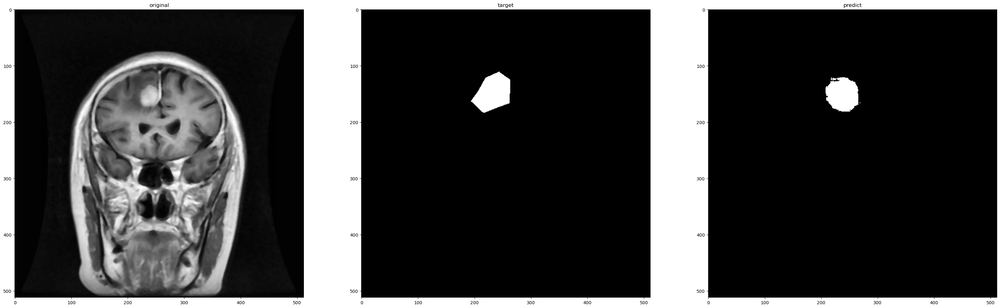

第46轮次已训练300批样本, 本批次平均loss值: 0.3293608530362447
第46轮次已训练600批样本, 本批次平均loss值: 0.32919099638859434
第46轮次已训练900批样本, 本批次平均loss值: 0.3276534566283226
第46轮次已训练1200批样本, 本批次平均loss值: 0.3308560143907865
第46轮次已训练1500批样本, 本批次平均loss值: 0.32906259804964066
第46轮次已训练1800批样本, 本批次平均loss值: 0.3301302497585615
第46轮次已训练2100批样本, 本批次平均loss值: 0.3292545094092687
第46轮次已训练2400批样本, 本批次平均loss值: 0.3293658249576886
第46轮次已训练2700批样本, 本批次平均loss值: 0.32896523853143056
current epoch average cross entropy loss: 0.3666437566280365
Dice score 0.7624501127884781


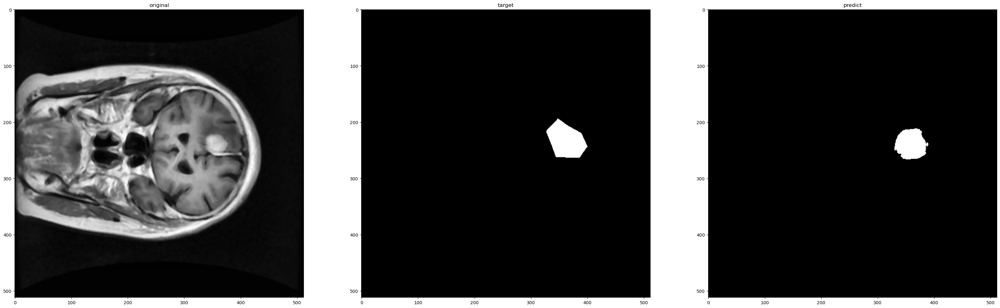

第47轮次已训练300批样本, 本批次平均loss值: 0.3308369055390358
第47轮次已训练600批样本, 本批次平均loss值: 0.3282400719324748
第47轮次已训练900批样本, 本批次平均loss值: 0.3296297384301821
第47轮次已训练1200批样本, 本批次平均loss值: 0.3302677129705747
第47轮次已训练1500批样本, 本批次平均loss值: 0.328683781127135
第47轮次已训练1800批样本, 本批次平均loss值: 0.32954108516375225
第47轮次已训练2100批样本, 本批次平均loss值: 0.32958838055531187
第47轮次已训练2400批样本, 本批次平均loss值: 0.3303033335010211
第47轮次已训练2700批样本, 本批次平均loss值: 0.32874535481135053
current epoch average cross entropy loss: 0.36755743622779846
Dice score 0.8007857259780651


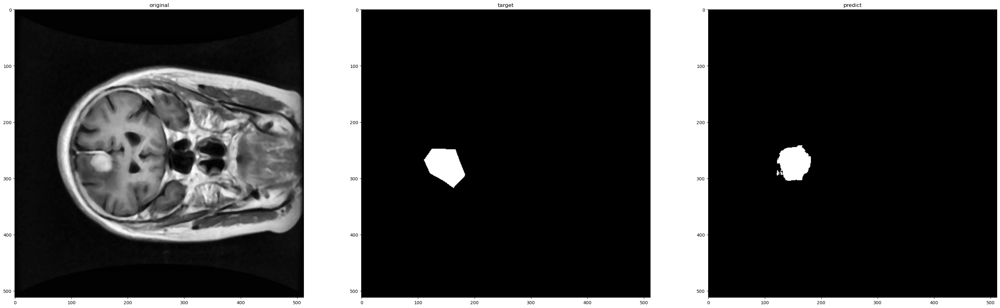

第48轮次已训练300批样本, 本批次平均loss值: 0.3289267497261365
第48轮次已训练600批样本, 本批次平均loss值: 0.3308596834540367
第48轮次已训练900批样本, 本批次平均loss值: 0.3273541916410128
第48轮次已训练1200批样本, 本批次平均loss值: 0.3304708139101664
第48轮次已训练1500批样本, 本批次平均loss值: 0.3304058070977529
第48轮次已训练1800批样本, 本批次平均loss值: 0.32997743010520936
第48轮次已训练2100批样本, 本批次平均loss值: 0.32879862437645596
第48轮次已训练2400批样本, 本批次平均loss值: 0.3299721863865852
第48轮次已训练2700批样本, 本批次平均loss值: 0.327882869442304
current epoch average cross entropy loss: 0.3667103052139282
Dice score 0.7624999999999998


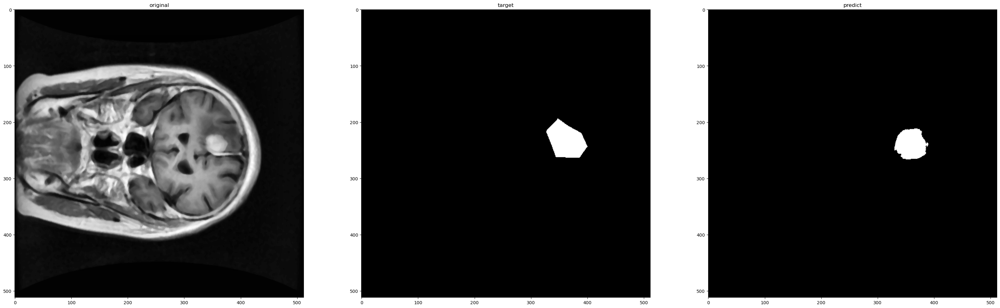

第49轮次已训练300批样本, 本批次平均loss值: 0.33059683720270794
第49轮次已训练600批样本, 本批次平均loss值: 0.329200427532196
第49轮次已训练900批样本, 本批次平均loss值: 0.32893739223480223
第49轮次已训练1200批样本, 本批次平均loss值: 0.3307217765847842
第49轮次已训练1500批样本, 本批次平均loss值: 0.3306312155723572
第49轮次已训练1800批样本, 本批次平均loss值: 0.32761092285315196
第49轮次已训练2100批样本, 本批次平均loss值: 0.32711199442545574
第49轮次已训练2400批样本, 本批次平均loss值: 0.33002348452806474
第49轮次已训练2700批样本, 本批次平均loss值: 0.33016329844792686
current epoch average cross entropy loss: 0.3672475516796112
Dice score 0.8009160804842138


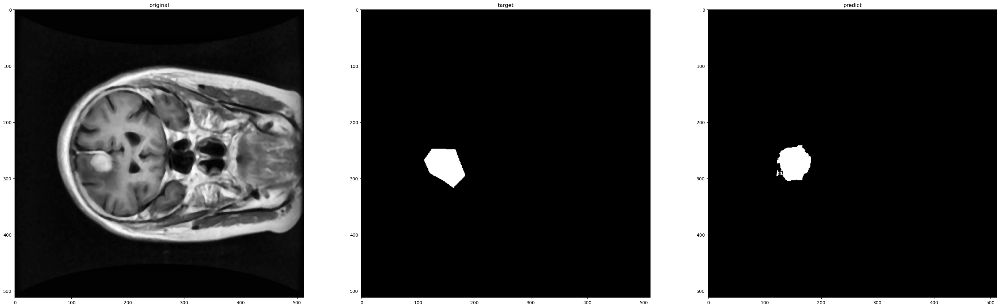

第50轮次已训练300批样本, 本批次平均loss值: 0.3291213880976041
第50轮次已训练600批样本, 本批次平均loss值: 0.32956419318914415
第50轮次已训练900批样本, 本批次平均loss值: 0.32900029053290686
第50轮次已训练1200批样本, 本批次平均loss值: 0.3306871063510577
第50轮次已训练1500批样本, 本批次平均loss值: 0.32939318150281904
第50轮次已训练1800批样本, 本批次平均loss值: 0.33222157617410025
第50轮次已训练2100批样本, 本批次平均loss值: 0.326973614692688
第50轮次已训练2400批样本, 本批次平均loss值: 0.33114508897066114
第50轮次已训练2700批样本, 本批次平均loss值: 0.3289640602469444
current epoch average cross entropy loss: 0.366780161857605
Dice score 0.8009811937857726


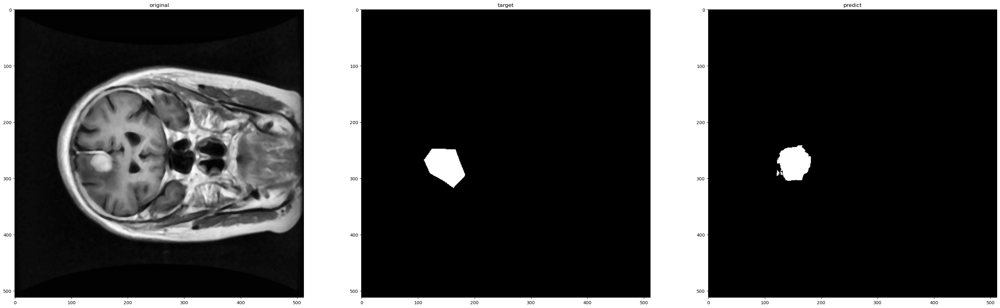

第51轮次已训练300批样本, 本批次平均loss值: 0.3305954932173093
第51轮次已训练600批样本, 本批次平均loss值: 0.3289971617857615
第51轮次已训练900批样本, 本批次平均loss值: 0.329894455075264
第51轮次已训练1200批样本, 本批次平均loss值: 0.32707357972860335
第51轮次已训练1500批样本, 本批次平均loss值: 0.3315666461984316
第51轮次已训练1800批样本, 本批次平均loss值: 0.3291088487704595
第51轮次已训练2100批样本, 本批次平均loss值: 0.32901132424672447
第51轮次已训练2400批样本, 本批次平均loss值: 0.32772064983844756
第51轮次已训练2700批样本, 本批次平均loss值: 0.32991701950629554
current epoch average cross entropy loss: 0.3659409284591675
Dice score 0.8166394779771614


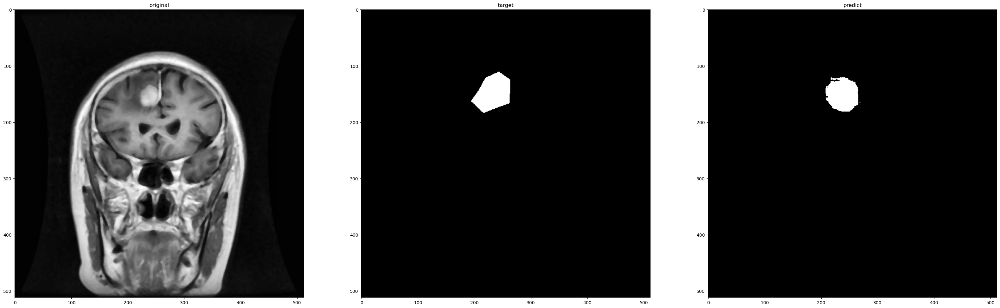

第52轮次已训练300批样本, 本批次平均loss值: 0.3303264886140823
第52轮次已训练600批样本, 本批次平均loss值: 0.33150238037109375
第52轮次已训练900批样本, 本批次平均loss值: 0.330065665046374
第52轮次已训练1200批样本, 本批次平均loss值: 0.32934865554173787
第52轮次已训练1500批样本, 本批次平均loss值: 0.3287768994768461
第52轮次已训练1800批样本, 本批次平均loss值: 0.3305146007736524
第52轮次已训练2100批样本, 本批次平均loss值: 0.32854148278633755
第52轮次已训练2400批样本, 本批次平均loss值: 0.32898421823978424
第52轮次已训练2700批样本, 本批次平均loss值: 0.328884970843792
current epoch average cross entropy loss: 0.36586394906044006
Dice score 0.816906005221932


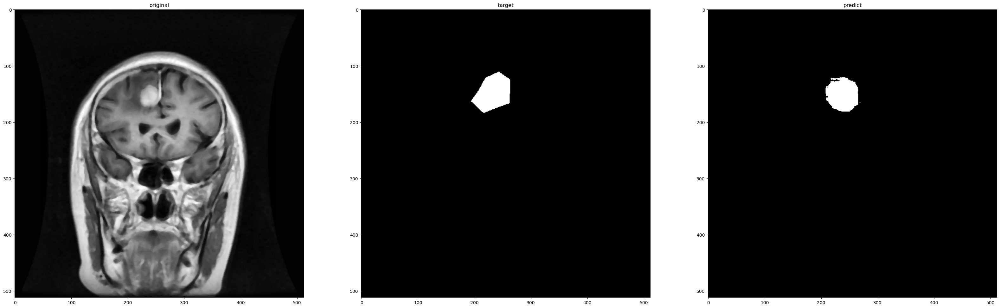

第53轮次已训练300批样本, 本批次平均loss值: 0.3277510256568591
第53轮次已训练600批样本, 本批次平均loss值: 0.3298470321297646
第53轮次已训练900批样本, 本批次平均loss值: 0.3297641842563947
第53轮次已训练1200批样本, 本批次平均loss值: 0.32981993158658346
第53轮次已训练1500批样本, 本批次平均loss值: 0.328650079369545
第53轮次已训练1800批样本, 本批次平均loss值: 0.33008285174767177
第53轮次已训练2100批样本, 本批次平均loss值: 0.33160842855771383
第53轮次已训练2400批样本, 本批次平均loss值: 0.32905692140261333
第53轮次已训练2700批样本, 本批次平均loss值: 0.3280356420079867
current epoch average cross entropy loss: 0.36769548058509827
Dice score 0.8165197518772445


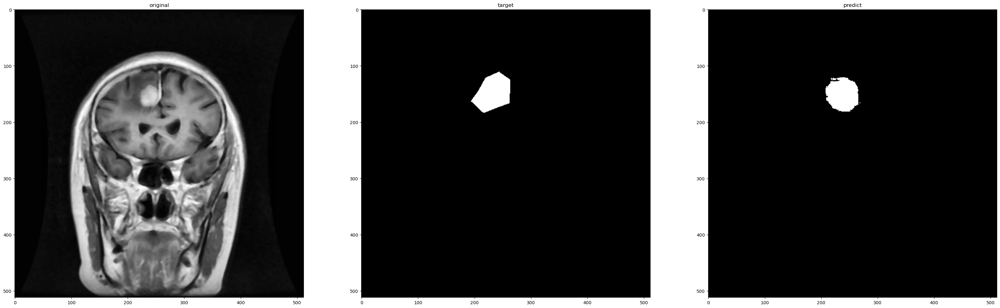

第54轮次已训练300批样本, 本批次平均loss值: 0.32816050281127296
第54轮次已训练600批样本, 本批次平均loss值: 0.3294027602672577
第54轮次已训练900批样本, 本批次平均loss值: 0.3291745886206627
第54轮次已训练1200批样本, 本批次平均loss值: 0.3303318792581558
第54轮次已训练1500批样本, 本批次平均loss值: 0.3305885441104571
第54轮次已训练1800批样本, 本批次平均loss值: 0.33017775078614553
第54轮次已训练2100批样本, 本批次平均loss值: 0.3299081359306971
第54轮次已训练2400批样本, 本批次平均loss值: 0.3288659790158272
第54轮次已训练2700批样本, 本批次平均loss值: 0.32913405150175096
current epoch average cross entropy loss: 0.36694616079330444
Dice score 0.7327221438645979


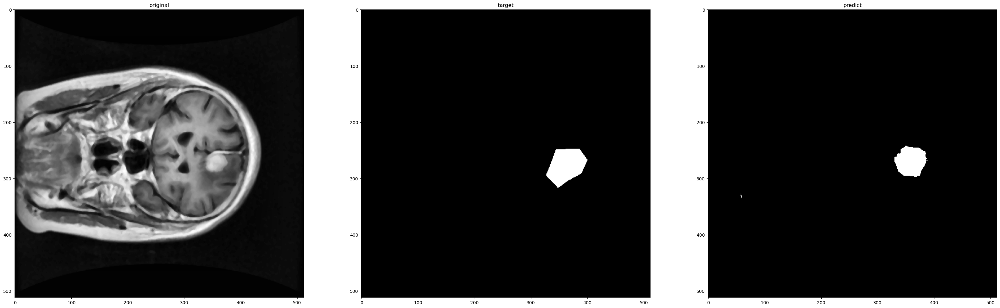

第55轮次已训练300批样本, 本批次平均loss值: 0.3291312861442566
第55轮次已训练600批样本, 本批次平均loss值: 0.32706029872099557
第55轮次已训练900批样本, 本批次平均loss值: 0.32897524585326515
第55轮次已训练1200批样本, 本批次平均loss值: 0.3302944959203402
第55轮次已训练1500批样本, 本批次平均loss值: 0.3300552901625633
第55轮次已训练1800批样本, 本批次平均loss值: 0.3288490486145019
第55轮次已训练2100批样本, 本批次平均loss值: 0.33082260688145954
第55轮次已训练2400批样本, 本批次平均loss值: 0.32972796698411305
第55轮次已训练2700批样本, 本批次平均loss值: 0.32904579828182856
current epoch average cross entropy loss: 0.3666737973690033
Dice score 0.7625824366539394


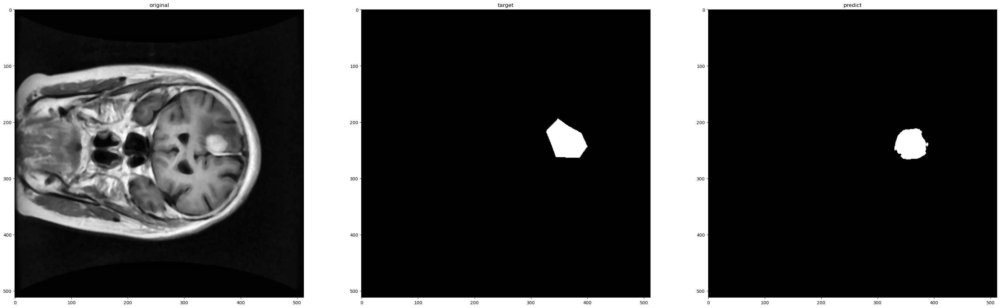

第56轮次已训练300批样本, 本批次平均loss值: 0.32757559607426323
第56轮次已训练600批样本, 本批次平均loss值: 0.3327516497174899
第56轮次已训练900批样本, 本批次平均loss值: 0.3298836728930473
第56轮次已训练1200批样本, 本批次平均loss值: 0.32812905857960384
第56轮次已训练1500批样本, 本批次平均loss值: 0.32986841489871344
第56轮次已训练1800批样本, 本批次平均loss值: 0.3296819269657135
第56轮次已训练2100批样本, 本批次平均loss值: 0.3276522135734558
第56轮次已训练2400批样本, 本批次平均loss值: 0.3289847764372826
第56轮次已训练2700批样本, 本批次平均loss值: 0.3297787657380104
current epoch average cross entropy loss: 0.36758357286453247
Dice score 0.8167129100701811


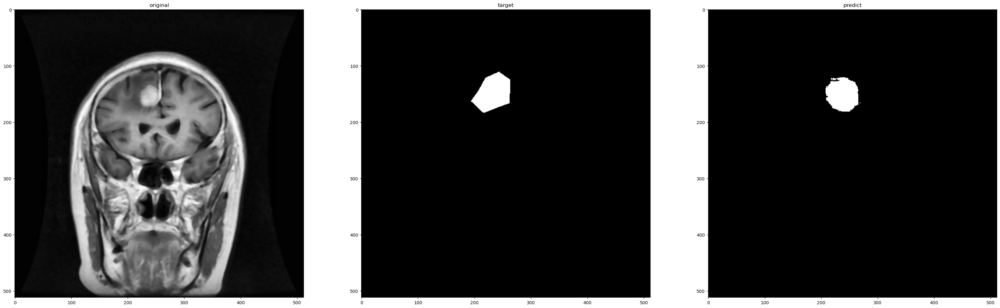

第57轮次已训练300批样本, 本批次平均loss值: 0.32953408400217693
第57轮次已训练600批样本, 本批次平均loss值: 0.33128770073254904
第57轮次已训练900批样本, 本批次平均loss值: 0.33009499301513034
第57轮次已训练1200批样本, 本批次平均loss值: 0.3288421039779981
第57轮次已训练1500批样本, 本批次平均loss值: 0.3284246553977331
第57轮次已训练1800批样本, 本批次平均loss值: 0.3291783178846041
第57轮次已训练2100批样本, 本批次平均loss值: 0.3284927518169085
第57轮次已训练2400批样本, 本批次平均loss值: 0.3304672075311343
第57轮次已训练2700批样本, 本批次平均loss值: 0.32887113799651463
current epoch average cross entropy loss: 0.3674566149711609
Dice score 0.7253955037468774


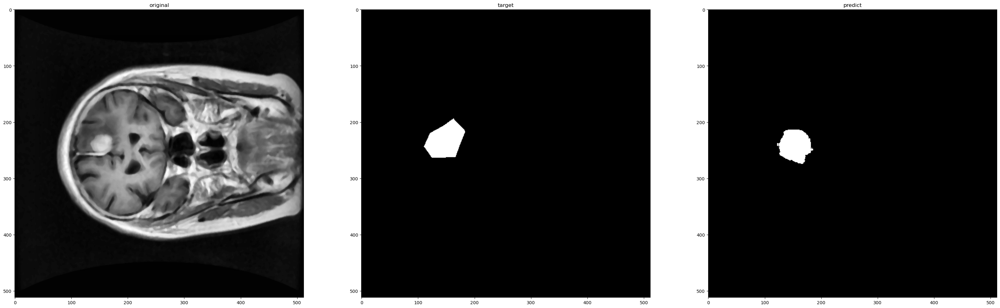

第58轮次已训练300批样本, 本批次平均loss值: 0.32798557172218956
第58轮次已训练600批样本, 本批次平均loss值: 0.3292712523539861
第58轮次已训练900批样本, 本批次平均loss值: 0.328553047478199
第58轮次已训练1200批样本, 本批次平均loss值: 0.3287089315056801
第58轮次已训练1500批样本, 本批次平均loss值: 0.32809358070294065
第58轮次已训练1800批样本, 本批次平均loss值: 0.32842332690954207
第58轮次已训练2100批样本, 本批次平均loss值: 0.3296064724524816
第58轮次已训练2400批样本, 本批次平均loss值: 0.33082864006360374
第58轮次已训练2700批样本, 本批次平均loss值: 0.3326895683010419
current epoch average cross entropy loss: 0.36654093861579895
Dice score 0.7246666666666666


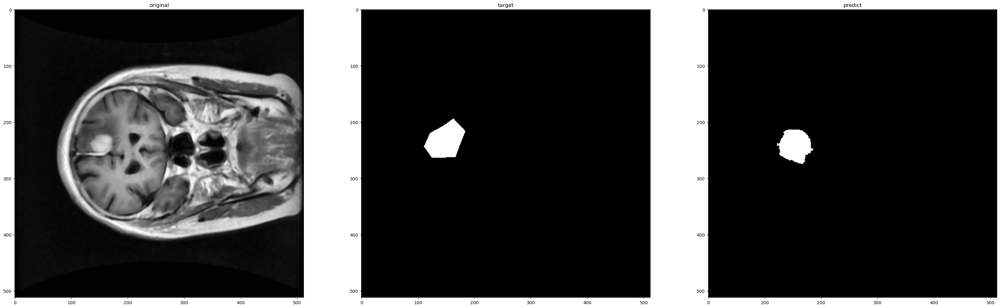

第59轮次已训练300批样本, 本批次平均loss值: 0.3285093904534976
第59轮次已训练600批样本, 本批次平均loss值: 0.32969886223475137
第59轮次已训练900批样本, 本批次平均loss值: 0.32850480248530706
第59轮次已训练1200批样本, 本批次平均loss值: 0.3302696165442467
第59轮次已训练1500批样本, 本批次平均loss值: 0.32959795504808426
第59轮次已训练1800批样本, 本批次平均loss值: 0.3294180656472842
第59轮次已训练2100批样本, 本批次平均loss值: 0.3280037855108579
第59轮次已训练2400批样本, 本批次平均loss值: 0.32987113485733666
第59轮次已训练2700批样本, 本批次平均loss值: 0.3301292183995247
current epoch average cross entropy loss: 0.3682601749897003
Dice score 0.8005893909626718


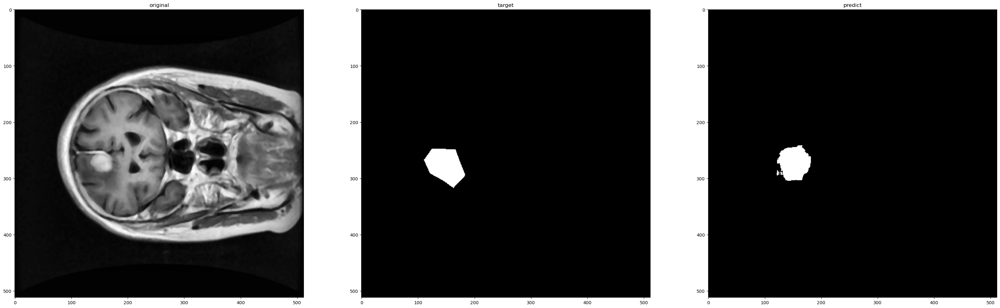

第60轮次已训练300批样本, 本批次平均loss值: 0.3283723226189613
第60轮次已训练600批样本, 本批次平均loss值: 0.330481239259243
第60轮次已训练900批样本, 本批次平均loss值: 0.33031897674004235
第60轮次已训练1200批样本, 本批次平均loss值: 0.33002433558305105
第60轮次已训练1500批样本, 本批次平均loss值: 0.329087989628315
第60轮次已训练1800批样本, 本批次平均loss值: 0.32934608787298203
第60轮次已训练2100批样本, 本批次平均loss值: 0.32793430268764495
第60轮次已训练2400批样本, 本批次平均loss值: 0.33081113000710805
第60轮次已训练2700批样本, 本批次平均loss值: 0.32949966748555504
current epoch average cross entropy loss: 0.3673882782459259
Dice score 0.7624999999999998


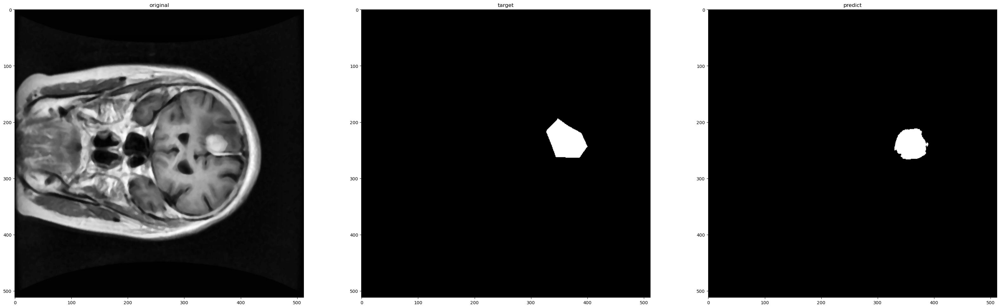

In [2]:
from main import *
batch_size=1
epochs=60
model=UNet(1, 2, False)
device=torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(torch.cuda.is_available())
model.to(device)
transform=transforms.Compose([transforms.ToTensor()])
train_dataset=TumorDataset(dataset_dir='./dataset/training/', train=True, transform=transform)
train_loader=DataLoader(train_dataset, shuffle=True, batch_size=batch_size)
test_dataset=TumorDataset(dataset_dir='./dataset/testing/', train=False, transform=transform)
test_loader=DataLoader(test_dataset, shuffle=False, batch_size=batch_size)
criterion=torch.nn.CrossEntropyLoss(weight=torch.tensor([0.1, 0.9], device=device))
optimizer=torch.optim.Adam(model.parameters(), lr=1e-4, betas=(0.9, 0.999), weight_decay=1e-8)
scheduler=torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=2)

for epoch in range(epochs):
    train(model, device, batch_size, train_loader, optimizer, criterion, epoch)
    test_loss=test(model, device, test_loader, criterion)
    scheduler.step(test_loss)

In [3]:
torch.save(model.state_dict(), 'epoch60.params')

In [4]:
for epoch in range(10):
    train(model, device, batch_size, train_loader, optimizer, criterion, epoch)
    test_loss=test(model, device, test_loader, criterion)
    scheduler.step(test_loss)

KeyboardInterrupt: 